# Libraries

In [ ]:
# === Работа с данными ===
import pandas as pd  # Для работы с таблицами (DataFrame)
import numpy as np  # Для работы с массивами и вычислений

# === Визуализация данных ===
import matplotlib.pyplot as plt  # Для построения графиков
import seaborn as sns  # Для продвинутой визуализации данных

# === Астрономические данные ===
from astropy.io import fits  # Для работы с FITS-файлами (астрономические данные)

# === Предобработка данных ===
from sklearn.preprocessing import (
    MultiLabelBinarizer,  # Для преобразования категориальных данных в бинарные метки
    LabelEncoder,  # Для кодирования категориальных данных
    StandardScaler,  # Для нормализации данных
    PolynomialFeatures,  # Для генерации полиномиальных признаков
    OneHotEncoder  # Для создания one-hot-кодировки
)

# === Разделение и выборка данных ===
from sklearn.model_selection import (
    train_test_split,  # Для разделения данных на тренировочные и тестовые выборки
    learning_curve,  # Для построения кривых обучения
    cross_val_score,  # Для оценки модели с кросс-валидацией
    GridSearchCV  # Для поиска гиперпараметров модели
)

# === Метрики оценки моделей ===
from sklearn.metrics import (
    accuracy_score,  # Точность
    f1_score,  # F1-метрика
    roc_auc_score,  # ROC-AUC метрика
    hamming_loss,  # Hamming loss
    jaccard_score,  # Jaccard-индекс
    classification_report,  # Подробный отчет по метрикам
    confusion_matrix,  # Матрица ошибок
    ConfusionMatrixDisplay  # Визуализация матрицы ошибок
)

# === Модели машинного обучения ===
from xgboost import XGBClassifier  # Классификатор XGBoost
from sklearn.ensemble import RandomForestClassifier  # Случайный лес
from sklearn.linear_model import LogisticRegression  # Логистическая регрессия

# === Оптимизация гиперпараметров ===
import optuna  # Для автоматической оптимизации гиперпараметров

# === Работа с весами классов ===
from sklearn.utils.class_weight import compute_class_weight  # Для вычисления весов классов

# === Нейронные сети ===
import tensorflow as tf  # Фреймворк для работы с нейронными сетями
from tensorflow.keras.models import Sequential, Model  # Создание нейронных сетей
from tensorflow.keras.layers import Dense, Dropout, Input  # Слои нейронной сети
from tensorflow.keras.optimizers import Adam  # Оптимизатор
from tensorflow.keras.regularizers import l2  # L2-регуляризация

# === Сохранение и загрузка моделей ===
from joblib import dump, load  # Для сохранения и загрузки моделей

# === Прочее ===
from tqdm import tqdm  # Прогресс-бары
import time  # Для измерения времени выполнения операций
import warnings  # Для управления предупреждениями
warnings.filterwarnings('ignore', category=UserWarning)  # Отключение предупреждений

# Plot parametres

In [6]:
plt.rcParams.update({
    'figure.figsize': (8, 6),  # Размеры графиков
    'figure.dpi': 100,  # Разрешение графиков
    'savefig.dpi': 300,  # Разрешение сохраненных изображений
    'font.size': 12,  # Размер шрифта
    'font.family': 'serif',  # Семейство шрифтов
    'axes.labelsize': 14,  # Размер шрифта для подписей осей
    'axes.titlesize': 14,  # Размер шрифта для заголовков
    'xtick.labelsize': 12,  # Размер шрифта для подписей меток на оси X
    'ytick.labelsize': 12,  # Размер шрифта для подписей меток на оси Y
    'legend.fontsize': 10,  # Размер шрифта для легенды
    'lines.linewidth': 1,  # Толщина линий
    'lines.markersize': 6,  # Размер маркеров
    'axes.grid': False,  # Сетка на графиках
    'grid.alpha': 0.25,  # Прозрачность сетки
    'grid.linestyle': '--',  # Стиль линии сетки
    'grid.color': 'gray',  # Цвет сетки
    'axes.axisbelow': True,  # Сетка ниже данных
    'image.cmap': 'viridis',  # Цветовая карта для изображений
    'errorbar.capsize': 3,  # Размер "колпачков" на графиках ошибок
    "legend.loc": 'best', 
})

# Data

## Load

In [10]:
df = pd.read_csv("enriched_catalog_progress.csv",low_memory=False)

In [11]:
df.columns

Index(['NAME', 'RA', 'DEC', 'SPECT_TYPE', 'MIN_MAG_LIMIT', 'MIN_MAG',
       'MAX_MAG_LIMIT', 'MAX_MAG', 'VARIABILITY_TYPE', 'PERIOD_LIMIT',
       'PERIOD', 'PERIOD_FLAG', 'VARIABLE_STAR_NUMBER', 'VARIABLE_STAR_CPT',
       'NOTE_FLAG', 'LII', 'BII', 'POSITION_FLAG', 'MAX_MAG_FLAG',
       'MIN_MAG_FLAG', 'MIN_MAG_ALT_SYS', 'SEC_MIN_MAG_LIMIT', 'SEC_MIN_MAG',
       'SEC_MIN_MAG_FLAG', 'SEC_MIN_MAG_ALT_SYS', 'MAG_SYSTEM', 'EPOCH',
       'EPOCH_PRECISION', 'EPOCH_FLAG', 'NOVA_YEAR', 'NOVA_YEAR_FLAG',
       'PERIOD_PRECISION', 'PERIOD_NOTE', 'RISE_ECLIPSE_TIME',
       'RISE_ECLIPSE_TIME_FLAG', 'ECLIPSE_VAR_NOTE', 'REF_STAR', 'REF_CHART',
       'COMMENT_FLAG', 'ALT_NAME', 'PM_RA', 'PM_DEC', 'COORDINATES_EPOCH',
       'COORDINATES_EPOCH_FLAG', 'REF_ASTROMETRY_FLAG', 'REF_ASTROMETRY',
       'NEW_VARIABILITY_TYPE', 'CLASS', 'SOURCE_ID', 'ra', 'dec', 'parallax',
       'pmra', 'pmdec', 'pm', 'phot_g_mean_mag', 'bp_rp', 'bp_g', 'g_rp',
       'phot_variable_flag', 'radial_velocity', 'ra

In [12]:
# Проверка числового значения или "--"
def is_numeric_or_dash(value):
    try:
        float(value)  # Проверяем, можно ли преобразовать в число
        return True
    except ValueError:
        return value == "--"  # Проверяем, если значение равно "--"

# Выбираем строки для обработки
mask = df["phot_variable_flag"].apply(is_numeric_or_dash)

# Обрабатываем строки
for index in df[mask].index:
    # Получаем значения начиная с `SOURCE_ID`
    values = df.loc[index, "SOURCE_ID":].values
    
    # Сохраняем последние три значения
    last_three_values = values[-3:]
    
    # Сдвигаем значения вправо на три позиции
    shifted_values = np.roll(values, shift=3)
    
    # Переносим последние три значения в начало
    shifted_values[:3] = last_three_values
    
    # Перезаписываем строку
    df.loc[index, "SOURCE_ID":] = shifted_values

In [13]:
df.phot_variable_flag.unique()

array(['VARIABLE', 'NOT_AVAILABLE', nan], dtype=object)

In [16]:
df.head()

,NAME,RA,DEC,SPECT_TYPE,MIN_MAG_LIMIT,MIN_MAG,MAX_MAG_LIMIT,MAX_MAG,VARIABILITY_TYPE,PERIOD_LIMIT,...,radial_velocity,radial_velocity_error,teff_gspphot,logg_gspphot,mh_gspphot,ag_gspphot,ebpminrp_gspphot,ruwe,VarType,SpType
0,EN Oct,222.56025,-89.78306,NaN,NaN,12.60,NaN,11.88,EW,NaN,...,-19.04358,25.011263,5538.571,4.3829,-0.398,0.0063,0.0034,1.0172755,EW,NaN
1,BQ Oct,218.87283,-89.77172,"M4III(S5,1)",(,0.10,NaN,6.80,LB:,NaN,...,-1.1699358,0.20221607,--,--,--,--,--,0.79556847,LB:,"M4III(S5,1)"
2,sig Oct,317.19521,-88.95650,F0IV,(,0.05,NaN,5.45,DSCTC,NaN,...,9.639548,0.385429,7191.9404,3.401,-0.5177,0.0476,0.0255,1.2973752,DSCTC,F0IV
3,CG Oct,341.37592,-88.81831,NaN,(,0.04,NaN,6.85,DSCTC,NaN,...,--,--,7144.3374,3.7116,-0.4963,0.0085,0.0046,0.7898268,DSCTC,NaN
4,Y Oct,217.26825,-88.64547,NaN,NaN,12.80,NaN,11.30,RRAB,NaN,...,126.03135,6.3963923,--,--,--,--,--,1.2386812,RRAB,NaN


In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58202 entries, 0 to 58201
Data columns (total 70 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   NAME                    58202 non-null  object 
 1   RA                      58202 non-null  float64
 2   DEC                     58202 non-null  float64
 3   SPECT_TYPE              14935 non-null  object 
 4   MIN_MAG_LIMIT           9977 non-null   object 
 5   MIN_MAG                 58202 non-null  float64
 6   MAX_MAG_LIMIT           6 non-null      object 
 7   MAX_MAG                 58202 non-null  float64
 8   VARIABILITY_TYPE        57379 non-null  object 
 9   PERIOD_LIMIT            164 non-null    object 
 10  PERIOD                  58202 non-null  float64
 11  PERIOD_FLAG             2649 non-null   object 
 12  VARIABLE_STAR_NUMBER    58202 non-null  int64  
 13  VARIABLE_STAR_CPT       42 non-null     object 
 14  NOTE_FLAG               12718 non-null

## General Cleaning

### Empty -> Nan

In [20]:
df.replace("--", np.NaN, inplace=True)
df.replace(r'^\s*$', np.NaN, regex=True, inplace=True)
df.head()

,NAME,RA,DEC,SPECT_TYPE,MIN_MAG_LIMIT,MIN_MAG,MAX_MAG_LIMIT,MAX_MAG,VARIABILITY_TYPE,PERIOD_LIMIT,...,radial_velocity,radial_velocity_error,teff_gspphot,logg_gspphot,mh_gspphot,ag_gspphot,ebpminrp_gspphot,ruwe,VarType,SpType
0,EN Oct,222.56025,-89.78306,NaN,NaN,12.60,NaN,11.88,EW,NaN,...,-19.04358,25.011263,5538.571,4.3829,-0.398,0.0063,0.0034,1.0172755,EW,NaN
1,BQ Oct,218.87283,-89.77172,"M4III(S5,1)",(,0.10,NaN,6.80,LB:,NaN,...,-1.1699358,0.20221607,NaN,NaN,NaN,NaN,NaN,0.79556847,LB:,"M4III(S5,1)"
2,sig Oct,317.19521,-88.95650,F0IV,(,0.05,NaN,5.45,DSCTC,NaN,...,9.639548,0.385429,7191.9404,3.401,-0.5177,0.0476,0.0255,1.2973752,DSCTC,F0IV
3,CG Oct,341.37592,-88.81831,NaN,(,0.04,NaN,6.85,DSCTC,NaN,...,NaN,NaN,7144.3374,3.7116,-0.4963,0.0085,0.0046,0.7898268,DSCTC,NaN
4,Y Oct,217.26825,-88.64547,NaN,NaN,12.80,NaN,11.30,RRAB,NaN,...,126.03135,6.3963923,NaN,NaN,NaN,NaN,NaN,1.2386812,RRAB,NaN


In [21]:
df = df[(df["RA"] != 0) & (df["DEC"] != 0)].reset_index().drop("index",axis=1)

In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58023 entries, 0 to 58022
Data columns (total 70 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   NAME                    58023 non-null  object 
 1   RA                      58023 non-null  float64
 2   DEC                     58023 non-null  float64
 3   SPECT_TYPE              14935 non-null  object 
 4   MIN_MAG_LIMIT           9977 non-null   object 
 5   MIN_MAG                 58023 non-null  float64
 6   MAX_MAG_LIMIT           6 non-null      object 
 7   MAX_MAG                 58023 non-null  float64
 8   VARIABILITY_TYPE        57365 non-null  object 
 9   PERIOD_LIMIT            164 non-null    object 
 10  PERIOD                  58023 non-null  float64
 11  PERIOD_FLAG             2647 non-null   object 
 12  VARIABLE_STAR_NUMBER    58023 non-null  int64  
 13  VARIABLE_STAR_CPT       42 non-null     object 
 14  NOTE_FLAG               12691 non-null

### Columns selection

In [24]:
df_crop_0 = df[["NAME","RA","DEC","SPECT_TYPE","VARIABILITY_TYPE","PERIOD_LIMIT","PERIOD","PERIOD_FLAG","LII","BII","NEW_VARIABILITY_TYPE","parallax","pmra","pmdec","pm","phot_g_mean_mag","bp_rp","bp_g","g_rp","phot_variable_flag","VarType","SpType"]]
df_crop_0.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58023 entries, 0 to 58022
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   NAME                  58023 non-null  object 
 1   RA                    58023 non-null  float64
 2   DEC                   58023 non-null  float64
 3   SPECT_TYPE            14935 non-null  object 
 4   VARIABILITY_TYPE      57365 non-null  object 
 5   PERIOD_LIMIT          164 non-null    object 
 6   PERIOD                58023 non-null  float64
 7   PERIOD_FLAG           2647 non-null   object 
 8   LII                   58023 non-null  object 
 9   BII                   58023 non-null  object 
 10  NEW_VARIABILITY_TYPE  15288 non-null  object 
 11  parallax              53051 non-null  object 
 12  pmra                  53044 non-null  object 
 13  pmdec                 53044 non-null  object 
 14  pm                    53044 non-null  object 
 15  phot_g_mean_mag    

### PERIOD

#### Limit

In [27]:
df_crop_0.PERIOD_LIMIT.unique()

array([nan, '(', '>', '<'], dtype=object)

In [28]:
df_crop_0[df_crop_0.PERIOD_LIMIT=='(']

,NAME,RA,DEC,SPECT_TYPE,VARIABILITY_TYPE,PERIOD_LIMIT,PERIOD,PERIOD_FLAG,LII,BII,...,pmra,pmdec,pm,phot_g_mean_mag,bp_rp,bp_g,g_rp,phot_variable_flag,VarType,SpType
664,TU Men,70.41929,-76.61292,pec(UG),UGSU,(,68.0,NaN,289.35605,-33.65061,...,8.44224592587898,26.442557541977553,27.757528,16.991947,1.207943,0.4194889,0.78845406,VARIABLE,UGSU,pec(UG)
688,Z Cha,121.86562,-76.53353,pec(UG),UGSU+EA,(,104.1,NaN,289.18628,-22.08303,...,-35.79145958908998,55.96087063752246,66.427765,15.705273628234863,0.787241,0.15292263,0.63431835,VARIABLE,UGSU+EA,pec(UG)
1439,AD Men,91.12850,-71.42286,NaN,UGSS,(,30.0,:,281.96685,-29.33218,...,0.049394440991932825,12.73335545275416,12.733451,18.505943298339844,0.90975,0.33356285,0.57618713,VARIABLE,UGSS,NaN
1458,VW Hyi,62.29700,-71.29483,pec(UG),UGSU,(,27.3,NaN,284.88826,-38.13379,...,51.34027511260139,12.250486540939303,52.78161,13.80180835723877,0.5169258,0.13116074,0.38576508,VARIABLE,UGSU,pec(UG)
1647,OY Car,151.59267,-70.23472,pec(UG),UGSU+EA,(,346.5,NaN,289.76539,-11.70663,...,-38.82951569195795,7.2857071899153985,39.50712203979492,15.580665588378906,0.3160076,0.033158302,0.2828493,VARIABLE,UGSU+EA,pec(UG)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57493,CP Dra,153.91583,73.43475,NaN,UG,(,354.0,NaN,136.3369,39.37624,...,-8.601206923742394,-7.092246958390032,11.148127,19.937122344970703,0.6376915,0.19928932,0.43840218,NOT_AVAILABLE,UG,NaN
57499,AQ Dra,300.71021,73.46336,F2,ISB,(,5.5,NaN,106.05402,21.0678,...,-24.696635323282564,9.301301062843299,26.390112,13.063718795776367,0.8731413,0.33406925,0.53907204,VARIABLE,ISB,F2
57580,V342 Cam,65.88675,74.88047,pec(UG),UGSU,(,197.0,:,135.55225,17.49262,...,16.834041730287222,7.618224381421531,18.477615,17.561548233032227,0.8886757,0.20947266,0.67920303,VARIABLE,UGSU,pec(UG)
57655,V590 Cas,50.92375,76.28150,NaN,UG:,(,375.0,:,131.68405,16.06945,...,2.1957785645104506,-13.076742315960072,13.259812,17.360767364501953,0.9634476,0.3383236,0.625124,VARIABLE,UG:,NaN


In [29]:
# Добавление новых столбцов is_bound и is_mean_cycle
df_crop_0.loc[:,'is_bound_period_final'] = df_crop_0['PERIOD_LIMIT'].apply(lambda x: 1 if x in ['>', '<'] else 0)
df_crop_0.loc[:,'is_mean_cycle_period_final'] = df_crop_0['PERIOD_LIMIT'].apply(lambda x: 1 if x == '(' else 0)

/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/2811203368.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_crop_0.loc[:,'is_bound_period_final'] = df_crop_0['PERIOD_LIMIT'].apply(lambda x: 1 if x in ['>', '<'] else 0)
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/2811203368.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_crop_0.loc[:,'is_mean_cycle_period_final'] = df_crop_0['PERIOD_LIMIT'].apply(lambda x: 1 if x == '(' else 0)


In [30]:
df_crop_0=df_crop_0.drop("PERIOD_LIMIT", axis=1)

#### Value

In [32]:
df_crop_0.PERIOD.info()

<class 'pandas.core.series.Series'>
RangeIndex: 58023 entries, 0 to 58022
Series name: PERIOD
Non-Null Count  Dtype  
--------------  -----  
58023 non-null  float64
dtypes: float64(1)
memory usage: 453.4 KB


In [33]:
df_crop_0.PERIOD.describe()

count    58023.000000
mean        57.786095
std        225.085328
min          0.000000
25%          0.000000
50%          0.498567
75%         10.604950
max      29000.000000
Name: PERIOD, dtype: float64

In [34]:
df_crop_0.loc[:,"PERIOD"] = df_crop_0.PERIOD.replace(0,np.NaN)

In [35]:
df_crop_0.PERIOD.info()

<class 'pandas.core.series.Series'>
RangeIndex: 58023 entries, 0 to 58022
Series name: PERIOD
Non-Null Count  Dtype  
--------------  -----  
37629 non-null  float64
dtypes: float64(1)
memory usage: 453.4 KB


In [36]:
np.log10(df_crop_0.PERIOD).describe()

count    37629.000000
mean         0.770397
std          1.218103
min         -2.935542
25%         -0.283538
50%          0.360120
75%          2.176091
max          4.462398
Name: PERIOD, dtype: float64

In [37]:
df_crop_0.loc[:,"period_final"] = np.log10(df_crop_0.loc[:,"PERIOD"])

#### Flag

In [39]:
df_crop_0.PERIOD_FLAG.value_counts()

PERIOD_FLAG
:    2641
(       4
/       2
Name: count, dtype: int64

In [40]:
df_crop_0 = df_crop_0[~df_crop_0['PERIOD_FLAG'].isin(['/', '(', ':'])].reset_index().drop(["index","PERIOD","PERIOD_FLAG"],axis=1)

In [41]:
df_crop_0.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55376 entries, 0 to 55375
Data columns (total 22 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   NAME                        55376 non-null  object 
 1   RA                          55376 non-null  float64
 2   DEC                         55376 non-null  float64
 3   SPECT_TYPE                  14091 non-null  object 
 4   VARIABILITY_TYPE            54720 non-null  object 
 5   LII                         55376 non-null  object 
 6   BII                         55376 non-null  object 
 7   NEW_VARIABILITY_TYPE        14392 non-null  object 
 8   parallax                    50612 non-null  object 
 9   pmra                        50605 non-null  object 
 10  pmdec                       50605 non-null  object 
 11  pm                          50605 non-null  object 
 12  phot_g_mean_mag             54041 non-null  object 
 13  bp_rp                       495

### pm

In [43]:
df_crop_0.pmra = df_crop_0.pmra.replace(0,np.NaN).astype("float")
df_crop_0.pmdec = df_crop_0.pmdec.replace(0,np.NaN).astype("float")
df_crop_0.pm = df_crop_0.pm.replace(0,np.NaN).astype("float")

In [44]:
df_crop_0[["pm","pmra","pmdec"]].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55376 entries, 0 to 55375
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   pm      50605 non-null  float64
 1   pmra    50605 non-null  float64
 2   pmdec   50605 non-null  float64
dtypes: float64(3)
memory usage: 1.3 MB


In [45]:
df_crop_0.pmra.describe()

count    50605.000000
mean        -1.523589
std         15.467131
min       -226.112039
25%         -4.529811
50%         -1.650784
75%          1.042801
max        541.145025
Name: pmra, dtype: float64

In [46]:
df_crop_0.pmdec.describe()

count    50605.000000
mean        -4.850980
std         13.529505
min       -368.112182
25%         -6.753580
50%         -3.367445
75%         -0.499215
max        198.283232
Name: pmdec, dtype: float64

In [47]:
df_crop_0.pm.describe()

count    50605.000000
mean        11.096274
std         18.027862
min          0.012492
25%          3.504119
50%          6.283095
75%         10.655986
max        554.714100
Name: pm, dtype: float64

### phot_g_mean_mag

In [49]:
df_crop_0.phot_g_mean_mag= df_crop_0.phot_g_mean_mag.replace(0,np.NaN).astype("float")

In [50]:
df_crop_0.phot_g_mean_mag.describe()

count    54041.000000
mean        13.437908
std          3.758051
min          1.731607
25%         10.912985
50%         13.297324
75%         15.991041
max         22.152822
Name: phot_g_mean_mag, dtype: float64

In [51]:
df_crop_0.phot_g_mean_mag.info()

<class 'pandas.core.series.Series'>
RangeIndex: 55376 entries, 0 to 55375
Series name: phot_g_mean_mag
Non-Null Count  Dtype  
--------------  -----  
54041 non-null  float64
dtypes: float64(1)
memory usage: 432.8 KB


### color

In [53]:
df_crop_0[["bp_rp","bp_g","g_rp"]] = df_crop_0[["bp_rp","bp_g","g_rp"]].replace(0,np.NaN).astype("float")

In [54]:
df_crop_0[["bp_rp","bp_g","g_rp"]].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55376 entries, 0 to 55375
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   bp_rp   49569 non-null  float64
 1   bp_g    49574 non-null  float64
 2   g_rp    49609 non-null  float64
dtypes: float64(3)
memory usage: 1.3 MB


In [55]:
df_crop_0[["bp_rp","bp_g","g_rp"]].describe()

,bp_rp,bp_g,g_rp
count,49569.000000,49574.000000,49609.000000
mean,2.093751,1.131658,0.962870
std,1.749549,1.336064,0.610838
min,-2.025822,-6.631654,-0.818087
25%,0.731171,0.244138,0.470147
50%,1.340877,0.513682,0.841497
75%,3.189580,1.824959,1.384095
max,8.752645,6.660159,7.562619


### Leaftovers

In [59]:
df_crop_0.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55376 entries, 0 to 55375
Data columns (total 22 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   NAME                        55376 non-null  object 
 1   RA                          55376 non-null  float64
 2   DEC                         55376 non-null  float64
 3   SPECT_TYPE                  14091 non-null  object 
 4   VARIABILITY_TYPE            54720 non-null  object 
 5   LII                         55376 non-null  object 
 6   BII                         55376 non-null  object 
 7   NEW_VARIABILITY_TYPE        14392 non-null  object 
 8   parallax                    50612 non-null  object 
 9   pmra                        50605 non-null  float64
 10  pmdec                       50605 non-null  float64
 11  pm                          50605 non-null  float64
 12  phot_g_mean_mag             54041 non-null  float64
 13  bp_rp                       495

In [62]:
# Преобразуем координаты LII, BII и parallax в числовой формат
df_crop_0['LII'] = pd.to_numeric(df_crop_0['LII'], errors='coerce')
df_crop_0['BII'] = pd.to_numeric(df_crop_0['BII'], errors='coerce')
df_crop_0['parallax'] = pd.to_numeric(df_crop_0['parallax'], errors='coerce')

In [63]:
df_crop_0.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55376 entries, 0 to 55375
Data columns (total 22 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   NAME                        55376 non-null  object 
 1   RA                          55376 non-null  float64
 2   DEC                         55376 non-null  float64
 3   SPECT_TYPE                  14091 non-null  object 
 4   VARIABILITY_TYPE            54720 non-null  object 
 5   LII                         55375 non-null  float64
 6   BII                         55374 non-null  float64
 7   NEW_VARIABILITY_TYPE        14392 non-null  object 
 8   parallax                    50612 non-null  float64
 9   pmra                        50605 non-null  float64
 10  pmdec                       50605 non-null  float64
 11  pm                          50605 non-null  float64
 12  phot_g_mean_mag             54041 non-null  float64
 13  bp_rp                       495

## Variability type Cleaning

In [67]:
df_crop_1 = df_crop_0.copy() # var

In [90]:
df_crop_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55376 entries, 0 to 55375
Data columns (total 22 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   NAME                        55376 non-null  object 
 1   RA                          55376 non-null  float64
 2   DEC                         55376 non-null  float64
 3   SPECT_TYPE                  14091 non-null  object 
 4   VARIABILITY_TYPE            54720 non-null  object 
 5   LII                         55375 non-null  float64
 6   BII                         55374 non-null  float64
 7   NEW_VARIABILITY_TYPE        14392 non-null  object 
 8   parallax                    50612 non-null  float64
 9   pmra                        50605 non-null  float64
 10  pmdec                       50605 non-null  float64
 11  pm                          50605 non-null  float64
 12  phot_g_mean_mag             54041 non-null  float64
 13  bp_rp                       495

### Cleaning

In [101]:
df_crop_1[df_crop_1["NEW_VARIABILITY_TYPE"].notna()][["VARIABILITY_TYPE","NEW_VARIABILITY_TYPE"]]

,VARIABILITY_TYPE,NEW_VARIABILITY_TYPE
85,EA,EA
87,SR,SR
89,M,M
91,M,M
93,EB,EC
...,...,...
55358,ELL,Ell
55361,LB,Lb
55362,DSCTC,DSct
55363,SRA,SR


In [103]:
len(df_crop_1[df_crop_1["VARIABILITY_TYPE"].notna()])

54720

In [105]:
df_crop_1["var_type_final"] = (
    df_crop_1["VARIABILITY_TYPE"]
    .fillna(df_crop_1["NEW_VARIABILITY_TYPE"])
    .fillna(df_crop_1["VarType"])
)
df_crop_1["var_type_final"].info()

<class 'pandas.core.series.Series'>
RangeIndex: 55376 entries, 0 to 55375
Series name: var_type_final
Non-Null Count  Dtype 
--------------  ----- 
54899 non-null  object
dtypes: object(1)
memory usage: 432.8+ KB


### Grouping

In [108]:
len(df_crop_1[df_crop_1["var_type_final"].notna()])

54899

In [110]:
df_crop_1["var_type_final"].nunique()

533

In [112]:
# Словарь для группировки типов переменности
variable_groups = {
    "Eruptive": [
        "FU", "GCAS", "I", "IA", "IB", "IN", "INA", "INB", "INT", "IT", "IN(YY)", "IS", "ISA", "ISA(YY)", "ISB", "INS", "INSA",
        "INS:", "INSB", "INSB(YY)", "INT(YY)", "INSB:", "INST", "INST(YY)", "INAT", "UV", "UVN", "UVN(YY)", "WR",
        "RCB", "RS", "SDOR"
    ],
    "Pulsating": [
        "ACYG", "BCEP", "BCEPS", "CEP", "CEP(B)", "CW", "CWA", "CWB", "DCEP", "DCEP(B)", "DCEPS", "DSCT", "DSCTC", 
        "DSCTC(B)", "DSCT(B)", "DSCT(B:)", "GDOR", "L", "LB", "LC", "M", "PVTEL", "RPHS", "RR","RRC:","RRC", "RR(B)", "RRAB", 
        "RRB", "RRB01:","RRB01:", "RRA", "RVA", "RVB", "SR", "SRA", "SRB", "SRC", "SRD", "SXPHE", "SXPHE(B)", "SXPXE", "ZZ",
        "ZZA", "ZZB", "LPB", "LPB(LBV)"
    ],
    "Rotating": [
        "ACV", "ACVO", "BY", "ELL", "FKCOM", "PSR", "SXARI"
    ],
    "Cataclysmic": [
        "N", "NA", "NB", "NC", "NL", "NR", "SN", "SNI", "SNII", "UG", "UGSS", "UGSU", "UGZ", "ZAND", "NAB"
    ],
    "Eclipsing": [
        "E", "EA", "EB", "EW", "GS", "PN", "RS", "WD", "WR", "AR", "D", "DM", "DS", "DW", "K", "KE", "KW", "SD", 
        "EC"
    ],
    "X-ray": [
        "X", "XB", "XBND", "XNG", "XNGP", "XI", "XJ", "XND", "XN", "XN:", "XNG", "XPM", "XP", "XPNG", "XPR", "XPRM",
        "XPM", "XBI", "XBPR", "XNDR", "XR:", "XM", "XF", "XR"
    ],
    "Other": [
        "BLLAC", "CST", "GAL", "L:", "QSO", "S", "*", "+", ":", "VAR:"
    ],
    "New": [
        "ZZO", "AM", "R", "BE", "BLBOO", "EP", "SRS", "LPB(LBV)"
    ]
}

def classify_variable_types(types):
    if not isinstance(types, str):  # Если значение не строка, вернуть "Unknown"
        return "Unknown"
    
    # Разделяем строку на отдельные типы и очищаем каждый элемент
    individual_types = set(
        var.strip() for var in types.replace("/", "+").replace(":", "").split("+")
    )
    
    # Определяем группы
    groups = set()
    for var_type in individual_types:
        for group, type_list in variable_groups.items():
            if var_type in type_list:
                groups.add(group)
    
    return "+".join(sorted(groups)) if groups else "Unknown"

# Применяем функцию к DataFrame
df_crop_1["var_type_group_final"] = df_crop_1["var_type_final"].apply(lambda x: classify_variable_types(x) if isinstance(x,str) and len(str(x))>0 else x)


In [114]:
df_crop_1["var_type_group_final"].unique()

array(['Eclipsing', 'Pulsating', nan, 'Other', 'Rotating', 'Cataclysmic',
       'Eclipsing+Eruptive', 'Cataclysmic+Eclipsing+New', 'Unknown',
       'New', 'Eruptive', 'Cataclysmic+Eclipsing', 'Eclipsing+Pulsating',
       'Pulsating+Rotating', 'Eclipsing+X-ray', 'X-ray', 'Rotating+X-ray',
       'Eruptive+Rotating', 'Eclipsing+Rotating', 'Cataclysmic+Pulsating',
       'Eclipsing+New', 'Cataclysmic+X-ray', 'Eclipsing+Pulsating+X-ray',
       'Eclipsing+Eruptive+Other+Rotating', 'Eclipsing+Other',
       'Eruptive+Pulsating', 'New+X-ray', 'Eclipsing+Eruptive+X-ray',
       'Cataclysmic+Eclipsing+Pulsating', 'Cataclysmic+Rotating',
       'Eclipsing+Eruptive+Rotating', 'Eruptive+X-ray',
       'Eclipsing+Eruptive+Pulsating', 'New+Pulsating'], dtype=object)

In [116]:
df_crop_2 = df_crop_1[(df_crop_1["var_type_group_final"].notna())&(df_crop_1["var_type_group_final"]!="Unknown")&(df_crop_1["var_type_group_final"]!="New")&(df_crop_1["var_type_group_final"]!="Other")].drop(["VARIABILITY_TYPE","NEW_VARIABILITY_TYPE","VarType","var_type_final","phot_variable_flag"],axis=1).reset_index().drop("index",axis=1)
df_crop_2["var_type_group_final"] = df_crop_2["var_type_group_final"].apply(lambda x: x.split("+"))

In [118]:
df_crop_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53860 entries, 0 to 53859
Data columns (total 19 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   NAME                        53860 non-null  object 
 1   RA                          53860 non-null  float64
 2   DEC                         53860 non-null  float64
 3   SPECT_TYPE                  13577 non-null  object 
 4   LII                         53859 non-null  float64
 5   BII                         53858 non-null  float64
 6   parallax                    49259 non-null  float64
 7   pmra                        49252 non-null  float64
 8   pmdec                       49252 non-null  float64
 9   pm                          49252 non-null  float64
 10  phot_g_mean_mag             52582 non-null  float64
 11  bp_rp                       48242 non-null  float64
 12  bp_g                        48246 non-null  float64
 13  g_rp                        482

In [120]:
df_crop_2.head()

,NAME,RA,DEC,SPECT_TYPE,LII,BII,parallax,pmra,pmdec,pm,phot_g_mean_mag,bp_rp,bp_g,g_rp,SpType,is_bound_period_final,is_mean_cycle_period_final,period_final,var_type_group_final
0,EN Oct,222.56025,-89.78306,NaN,303.05249,-26.93976,3.789246,-5.210282,4.755414,7.054148,11.980466,0.945226,0.369872,0.575354,NaN,0,0,-0.539243,[Eclipsing]
1,BQ Oct,218.87283,-89.77172,"M4III(S5,1)",303.04421,-26.92306,1.823725,-8.021890,-8.667740,11.810184,5.533397,2.788678,1.557711,1.230967,"M4III(S5,1)",0,0,NaN,[Pulsating]
2,sig Oct,317.19521,-88.95650,F0IV,303.90523,-27.71347,11.100476,26.322593,4.720700,26.742548,5.374763,0.418131,0.148731,0.269401,F0IV,0,0,-1.013228,[Pulsating]
3,CG Oct,341.37592,-88.81831,NaN,303.63172,-28.13425,9.641358,22.188353,-35.803178,42.121143,6.500398,0.402781,0.139544,0.263236,NaN,0,0,NaN,[Pulsating]
4,Y Oct,217.26825,-88.64547,NaN,303.55409,-25.89342,0.489330,-25.733357,1.252075,25.763800,12.249489,0.717911,0.218515,0.499395,NaN,0,0,-0.189347,[Pulsating]


In [122]:
df_crop_2.var_type_group_final.value_counts()

var_type_group_final
[Pulsating]                               32971
[Eclipsing]                               11713
[Eruptive]                                 4946
[Rotating]                                 1863
[Cataclysmic]                              1041
[Eclipsing, Eruptive]                       888
[X-ray]                                     134
[Cataclysmic, Eclipsing]                     84
[Eclipsing, Pulsating]                       54
[Eruptive, Rotating]                         48
[Eclipsing, X-ray]                           29
[Cataclysmic, Pulsating]                     18
[Pulsating, Rotating]                        13
[Eclipsing, New]                             13
[Rotating, X-ray]                            10
[Eclipsing, Rotating]                         8
[Eclipsing, Eruptive, Rotating]               6
[Cataclysmic, X-ray]                          4
[Eruptive, Pulsating]                         3
[New, X-ray]                                  2
[Eclipsing, Eruptiv

In [124]:
# Определяем значения, которые нужно удалить
unwanted_types = {"Other", "New", "Unknown"}

# Функция для фильтрации списка
def filter_var_types(var_types):
    return [vt for vt in var_types if vt not in unwanted_types]

# Применяем функцию к столбцу
df_crop_2["var_type_group_final"] = df_crop_2["var_type_group_final"].apply(filter_var_types)

# Фильтруем строки, где список стал пустым
df_crop_2 = df_crop_2[df_crop_2["var_type_group_final"].map(len) > 0].reset_index(drop=True)

# Проверяем результаты
df_crop_2["var_type_group_final"].value_counts()

var_type_group_final
[Pulsating]                            32973
[Eclipsing]                            11727
[Eruptive]                              4946
[Rotating]                              1863
[Cataclysmic]                           1041
[Eclipsing, Eruptive]                    888
[X-ray]                                  136
[Cataclysmic, Eclipsing]                  85
[Eclipsing, Pulsating]                    54
[Eruptive, Rotating]                      48
[Eclipsing, X-ray]                        29
[Cataclysmic, Pulsating]                  18
[Pulsating, Rotating]                     13
[Rotating, X-ray]                         10
[Eclipsing, Rotating]                      8
[Eclipsing, Eruptive, Rotating]            7
[Cataclysmic, X-ray]                       4
[Eruptive, Pulsating]                      3
[Eclipsing, Eruptive, X-ray]               2
[Eclipsing, Pulsating, X-ray]              1
[Cataclysmic, Eclipsing, Pulsating]        1
[Cataclysmic, Rotating]           

In [126]:
df_crop_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53860 entries, 0 to 53859
Data columns (total 19 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   NAME                        53860 non-null  object 
 1   RA                          53860 non-null  float64
 2   DEC                         53860 non-null  float64
 3   SPECT_TYPE                  13577 non-null  object 
 4   LII                         53859 non-null  float64
 5   BII                         53858 non-null  float64
 6   parallax                    49259 non-null  float64
 7   pmra                        49252 non-null  float64
 8   pmdec                       49252 non-null  float64
 9   pm                          49252 non-null  float64
 10  phot_g_mean_mag             52582 non-null  float64
 11  bp_rp                       48242 non-null  float64
 12  bp_g                        48246 non-null  float64
 13  g_rp                        482

In [128]:
df_crop_var = df_crop_2.copy()
df_crop_var = df_crop_var.drop(["NAME","SPECT_TYPE","SpType"],axis=1)

In [130]:
df_crop_var.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53860 entries, 0 to 53859
Data columns (total 16 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   RA                          53860 non-null  float64
 1   DEC                         53860 non-null  float64
 2   LII                         53859 non-null  float64
 3   BII                         53858 non-null  float64
 4   parallax                    49259 non-null  float64
 5   pmra                        49252 non-null  float64
 6   pmdec                       49252 non-null  float64
 7   pm                          49252 non-null  float64
 8   phot_g_mean_mag             52582 non-null  float64
 9   bp_rp                       48242 non-null  float64
 10  bp_g                        48246 non-null  float64
 11  g_rp                        48282 non-null  float64
 12  is_bound_period_final       53860 non-null  int64  
 13  is_mean_cycle_period_final  538

## Spectral type Cleaning

In [133]:
df_crop_3 = df_crop_0.copy() # spec
df_crop_3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55376 entries, 0 to 55375
Data columns (total 22 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   NAME                        55376 non-null  object 
 1   RA                          55376 non-null  float64
 2   DEC                         55376 non-null  float64
 3   SPECT_TYPE                  14091 non-null  object 
 4   VARIABILITY_TYPE            54720 non-null  object 
 5   LII                         55375 non-null  float64
 6   BII                         55374 non-null  float64
 7   NEW_VARIABILITY_TYPE        14392 non-null  object 
 8   parallax                    50612 non-null  float64
 9   pmra                        50605 non-null  float64
 10  pmdec                       50605 non-null  float64
 11  pm                          50605 non-null  float64
 12  phot_g_mean_mag             54041 non-null  float64
 13  bp_rp                       495

In [135]:
df_crop_3 = df_crop_3.drop(["VARIABILITY_TYPE","NEW_VARIABILITY_TYPE","VarType","phot_variable_flag"],axis=1)

In [137]:
len(df_crop_3[df_crop_3["SPECT_TYPE"].notna()])

14091

In [139]:
df_crop_3.loc[:, "spec_type_final"] = df_crop_3["SPECT_TYPE"].where(
    df_crop_3["SPECT_TYPE"].notna(),
    df_crop_3["SpType"]
)
df_crop_3["spec_type_final"].info()

<class 'pandas.core.series.Series'>
RangeIndex: 55376 entries, 0 to 55375
Series name: spec_type_final
Non-Null Count  Dtype 
--------------  ----- 
14396 non-null  object
dtypes: object(1)
memory usage: 432.8+ KB


In [141]:
def classify_spectral_type(spectral_type):
    # Убираем пробелы, лишние символы и приводим к верхнему регистру
    spectral_type = str(spectral_type).strip().upper()

    # Определяем группы
    if spectral_type.startswith("O"):
        return "O"
    elif spectral_type.startswith("B"):
        return "B"
    elif spectral_type.startswith("A"):
        return "A"
    elif spectral_type.startswith("F"):
        return "F"
    elif spectral_type.startswith("G"):
        return "G"
    elif spectral_type.startswith("K"):
        return "K"
    elif spectral_type.startswith("M"):
        return "M"
    elif spectral_type.startswith("C"):
        return "C (Carbon)"
    elif spectral_type.startswith("S"):
        return "S (Zirconium)"
    elif spectral_type.startswith("D"):
        return "WD (White Dwarf)"
    elif "PEC" in spectral_type or any(x in spectral_type for x in ["AP", "AM", "BA", "SI"]):
        return "Peculiar"
    elif spectral_type.startswith("SD") or "SUB" in spectral_type:
        return "Subdwarf"
    elif "+" in spectral_type or "/" in spectral_type:
        return "Multiple"
    elif spectral_type in ["N", "ABS", "CONT", "26", "(QSO)"]:
        return "Uncertain"
    else:
        return "Other"

# Применяем к DataFrame
df_crop_3["spectral_group_final"] = df_crop_3["SPECT_TYPE"].apply(classify_spectral_type)

In [143]:
df_crop_3["spectral_group_final"].unique()

array(['Other', 'M', 'F', 'A', 'S (Zirconium)', 'K', 'G', 'Peculiar', 'B',
       'C (Carbon)', 'WD (White Dwarf)', 'O', 'Multiple', 'Uncertain'],
      dtype=object)

In [145]:
df_crop_4=df_crop_3[(df_crop_3["spectral_group_final"].notna())&(df_crop_3["spectral_group_final"]!="Uncertain")&(df_crop_3["spectral_group_final"]!="Other")&(df_crop_3["spectral_group_final"]!="Multiple")].reset_index().drop("index",axis=1)

In [147]:
df_crop_4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13578 entries, 0 to 13577
Data columns (total 20 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   NAME                        13578 non-null  object 
 1   RA                          13578 non-null  float64
 2   DEC                         13578 non-null  float64
 3   SPECT_TYPE                  13578 non-null  object 
 4   LII                         13578 non-null  float64
 5   BII                         13578 non-null  float64
 6   parallax                    12550 non-null  float64
 7   pmra                        12545 non-null  float64
 8   pmdec                       12545 non-null  float64
 9   pm                          12545 non-null  float64
 10  phot_g_mean_mag             13229 non-null  float64
 11  bp_rp                       12481 non-null  float64
 12  bp_g                        12481 non-null  float64
 13  g_rp                        124

In [149]:
df_crop_spec = df_crop_4.copy()
df_crop_spec = df_crop_spec.drop(["NAME","SPECT_TYPE","SpType","spec_type_final"],axis=1)

In [151]:
df_crop_spec.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13578 entries, 0 to 13577
Data columns (total 16 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   RA                          13578 non-null  float64
 1   DEC                         13578 non-null  float64
 2   LII                         13578 non-null  float64
 3   BII                         13578 non-null  float64
 4   parallax                    12550 non-null  float64
 5   pmra                        12545 non-null  float64
 6   pmdec                       12545 non-null  float64
 7   pm                          12545 non-null  float64
 8   phot_g_mean_mag             13229 non-null  float64
 9   bp_rp                       12481 non-null  float64
 10  bp_g                        12481 non-null  float64
 11  g_rp                        12486 non-null  float64
 12  is_bound_period_final       13578 non-null  int64  
 13  is_mean_cycle_period_final  135

# Variable type

## Data

In [153]:
df_crop_var.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53860 entries, 0 to 53859
Data columns (total 16 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   RA                          53860 non-null  float64
 1   DEC                         53860 non-null  float64
 2   LII                         53859 non-null  float64
 3   BII                         53858 non-null  float64
 4   parallax                    49259 non-null  float64
 5   pmra                        49252 non-null  float64
 6   pmdec                       49252 non-null  float64
 7   pm                          49252 non-null  float64
 8   phot_g_mean_mag             52582 non-null  float64
 9   bp_rp                       48242 non-null  float64
 10  bp_g                        48246 non-null  float64
 11  g_rp                        48282 non-null  float64
 12  is_bound_period_final       53860 non-null  int64  
 13  is_mean_cycle_period_final  538

In [155]:
df_crop_var['var_type_group_final'] = df_crop_var['var_type_group_final'].apply(lambda x: ', '.join(x) if isinstance(x, list) else x)


In [280]:
# Функция для заполнения NaN медианой внутри каждой группы
def fill_na_with_group_median(df, group_col, target_cols):
    for col in target_cols:
        df[col] = df.groupby(group_col)[col].transform(
            lambda x: x.fillna(x.median()) if not x.median() is None else x.fillna(0)
        )
    return df

# Заполняем медианами для каждой группы var_type_group_final
target_columns = ['period_final', 'pm', 'phot_g_mean_mag', 'bp_rp', 'LII', 'BII']
df_crop_var = fill_na_with_group_median(df_crop_var, 'var_type_group_final', target_columns)

# Проверим, остались ли пропуски
for col in ['period_final', 'pm', 'phot_g_mean_mag', 'bp_rp']:
    print(f"\nПропуски в {col}:")
    missing_groups = df_crop_var[df_crop_var[col].isna()]['var_type_group_final'].value_counts()
    print(missing_groups)


Пропуски в period_final:
Series([], Name: count, dtype: int64)

Пропуски в pm:
Series([], Name: count, dtype: int64)

Пропуски в phot_g_mean_mag:
Series([], Name: count, dtype: int64)

Пропуски в bp_rp:
Series([], Name: count, dtype: int64)


In [296]:
# Функция для расчета медианы по отдельным типам переменности
def fill_missing_with_median(df, target_col, group_col):
    # Создаем копию, чтобы избежать изменения оригинальных данных
    df = df.copy()
    
    # Словарь для хранения медиан по каждому типу переменности
    type_medians = {}
    
    # Рассчитываем медианы для каждого отдельного типа переменности
    all_types = set(sum(df[group_col].apply(lambda x: x.split(", ")).tolist(), []))
    for var_type in all_types:
        type_medians[var_type] = df[df[group_col].str.contains(var_type, na=False)][target_col].median()
    
    # Заполняем пропуски
    def calculate_median_for_row(row):
        if pd.isna(row[target_col]):
            # Получаем типы переменности для данной строки
            types_in_group = row[group_col].split(", ")
            # Берем медианы всех типов и возвращаем среднее
            medians = [type_medians[vt] for vt in types_in_group if vt in type_medians]
            return sum(medians) / len(medians) if medians else None
        return row[target_col]
    
    df[target_col] = df.apply(calculate_median_for_row, axis=1)
    return df

# Применяем функцию к каждому столбцу с пропусками
columns_to_fill = ['period_final', 'pm', 'phot_g_mean_mag', 'bp_rp', 'parallax','pmra', 'pmdec','bp_g', 'g_rp']
for col in columns_to_fill:
    df_crop_var = fill_missing_with_median(df_crop_var, col, 'var_type_group_final')

# Проверяем, остались ли пропуски
print(df_crop_var[columns_to_fill].isna().sum())

period_final       0
pm                 0
phot_g_mean_mag    0
bp_rp              0
parallax           0
pmra               0
pmdec              0
bp_g               0
g_rp               0
dtype: int64


In [297]:
# Инициализируем бинaризатор
mlb = MultiLabelBinarizer()

# Преобразуем столбец var_type_group_final
y_var = mlb.fit_transform(df_crop_var['var_type_group_final'])

# Отбираем только числовые признаки
X_var = df_crop_var[['LII', 'BII', 'parallax', 'pmra', 'pmdec', 'pm',
       'phot_g_mean_mag', 'bp_rp', 'bp_g', 'g_rp', 'is_bound_period_final',
       'is_mean_cycle_period_final', 'period_final']]

In [298]:
# Calculating galactic distance
R_sun = 8.2  # Distance from the Sun to the galactic center in kpc
X_var['R_gal'] = np.sqrt(
    R_sun**2 + (1 / X_var['parallax'])**2 - 
    2 * R_sun * (1 / X_var['parallax']) * np.cos(np.radians(X_var['LII'])) * np.cos(np.radians(X_var['BII']))
)

/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/2991054666.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_var['R_gal'] = np.sqrt(


In [299]:
X_var.columns

Index(['LII', 'BII', 'parallax', 'pmra', 'pmdec', 'pm', 'phot_g_mean_mag',
       'bp_rp', 'bp_g', 'g_rp', 'is_bound_period_final',
       'is_mean_cycle_period_final', 'period_final', 'R_gal'],
      dtype='object')

In [300]:
print(X_var.isna().sum())

LII                           0
BII                           0
parallax                      0
pmra                          0
pmdec                         0
pm                            0
phot_g_mean_mag               0
bp_rp                         0
bp_g                          0
g_rp                          0
is_bound_period_final         0
is_mean_cycle_period_final    0
period_final                  0
R_gal                         0
dtype: int64


## XGBClassifier

### Full

In [306]:
# Делим данные на тренировочные и тестовые
X_train_xgb, X_test_xgb, y_train_xgb, y_test_xgb = train_test_split(X_var, y_var, test_size=0.2, random_state=42)

In [307]:
from sklearn.utils.class_weight import compute_class_weight
import numpy as np

# Преобразуем многометочную задачу в веса для каждого класса
class_weights_xgb = []
for i in range(y_train_xgb.shape[1]):  # Для каждой метки
    weights_xgb = compute_class_weight(
        class_weight="balanced",
        classes=np.array([0, 1]),
        y=y_train_xgb[:, i]
    )
    class_weights_xgb.append(weights_xgb)

# Генерируем sample_weight для всех образцов
sample_weights_xgb = np.zeros(y_train_xgb.shape[0])
for i in range(y_train_xgb.shape[1]):
    sample_weights_xgb += np.where(
        y_train_xgb[:, i] == 1, class_weights_xgb[i][1], class_weights_xgb[i][0]
)

In [308]:
sample_weights_xgb

array([14.10831924, 20.98612619, 20.98612619, ..., 48.63519189,
       14.10831924, 14.10831924])

In [309]:
# Определение целевой функции для Optuna
def objective_xgb(trial):
    # Гиперпараметры для настройки
    param_xgb = {
        "objective": "binary:logistic",
        "n_estimators": trial.suggest_int("n_estimators", 50, 200),
        "max_depth": trial.suggest_int("max_depth", 4, 8),
        "subsample": trial.suggest_float("subsample", 0.6, 0.8),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, .8),
        "lambda": trial.suggest_loguniform("lambda", 5, 10.0),  # L2-регуляризация
        "alpha": trial.suggest_loguniform("alpha", 2, 10.0),    # L1-регуляризация
        "random_state": 42
    }

    # Модель XGBoost
    model_xgb = XGBClassifier(**param_xgb)
    model_xgb.fit(X_train_xgb, y_train_xgb, sample_weight=sample_weights_xgb)

    # Оценка F1 (micro) на тестовых данных
    y_pred_xgb = model_xgb.predict(X_test_xgb)
    return f1_score(y_test_xgb, y_pred_xgb, average="micro")

# Отслеживание времени начала
start_time_xgb = time.time()

# Создание и запуск Optuna-исследования
study_xgb = optuna.create_study(direction="maximize")
study_xgb.optimize(objective_xgb, n_trials=50)

# Отслеживание времени завершения
end_time_xgb = time.time()

# Лучшие параметры
best_params_xgb = study_xgb.best_params
print("\nЛучшие параметры:", best_params_xgb)
print("Лучший F1 (Micro):", study_xgb.best_value)

# Время выполнения
execution_time_xgb = end_time_xgb - start_time_xgb
print(f"\nВремя выполнения: {execution_time_xgb:.2f} секунд ({execution_time_xgb / 60:.2f} минут)")

[I 2025-01-09 15:25:26,654] A new study created in memory with name: no-name-4f08f6dc-bd45-42f4-8086-4d62828e2419
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/2278826857.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda": trial.suggest_loguniform("lambda", 5, 10.0),  # L2-регуляризация
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/2278826857.py:11: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "alpha": trial.suggest_loguniform("alpha", 2, 10.0),    # L1-регуляризация
[I 2025-01-09 15:25:30,585] Trial 0 finished with value: 0.9754227949983232 and parameters: {'n_estimators': 127, 'max_depth': 8, 'subsample': 0.7982691072447


Лучшие параметры: {'n_estimators': 183, 'max_depth': 8, 'subsample': 0.7635936350918057, 'colsample_bytree': 0.7623575353436434, 'lambda': 6.542393351437783, 'alpha': 4.785185112266913}
Лучший F1 (Micro): 0.9756650471745805

Время выполнения: 459.23 секунд (7.65 минут)


In [310]:
# Обучение финальной модели с лучшими параметрами
best_model_xgb = XGBClassifier(**best_params_xgb, random_state=42)
best_model_xgb.fit(X_train_xgb, y_train_xgb)

# Оценка модели
y_train_pred_xgb = best_model_xgb.predict(X_train_xgb)
y_test_pred_xgb = best_model_xgb.predict(X_test_xgb)

hamming_train_xgb = hamming_loss(y_train_xgb, y_train_pred_xgb)
f1_micro_train_xgb = f1_score(y_train_xgb, y_train_pred_xgb, average="micro")
f1_macro_train_xgb = f1_score(y_train_xgb, y_train_pred_xgb, average="macro")
roc_auc_micro_train_xgb = roc_auc_score(y_train_xgb, best_model_xgb.predict_proba(X_train_xgb), average="micro", multi_class="ovr")

hamming_test_xgb = hamming_loss(y_test_xgb, y_test_pred_xgb)
f1_micro_test_xgb = f1_score(y_test_xgb, y_test_pred_xgb, average="micro")
f1_macro_test_xgb = f1_score(y_test_xgb, y_test_pred_xgb, average="macro")
roc_auc_micro_test_xgb = roc_auc_score(y_test_xgb, best_model_xgb.predict_proba(X_test_xgb), average="micro", multi_class="ovr")

# Точность на тренировочных данных
accuracy_train_xgb = accuracy_score(y_train_xgb, y_train_pred_xgb)

# Точность на тестовых данных
accuracy_test_xgb = accuracy_score(y_test_xgb, y_test_pred_xgb)

In [313]:
# Вывод результатов
print(f"\nВремя выполнения: {execution_time_xgb:.2f} секунд ({execution_time_xgb / 60:.2f} минут)")
print("\nОценка модели:")
print(f"Hamming Loss (Train): {hamming_train_xgb:.4f}")
print(f"Hamming Loss (Test): {hamming_test_xgb:.4f}")
print(f"F1 Score Micro (Train): {f1_micro_train_xgb:.4f}")
print(f"F1 Score Micro (Test): {f1_micro_test_xgb:.4f}")
print(f"F1 Score Macro (Train): {f1_macro_train_xgb:.4f}")
print(f"F1 Score Macro (Test): {f1_macro_test_xgb:.4f}")
print(f"ROC-AUC Micro (Train): {roc_auc_micro_train_xgb:.4f}")
print(f"ROC-AUC Micro (Test): {roc_auc_micro_test_xgb:.4f}")
print(f"Accuracy (Train): {accuracy_train_xgb:.4f}")
print(f"Accuracy (Test): {accuracy_test_xgb:.4f}")


Время выполнения: 459.23 секунд (7.65 минут)

Оценка модели:
Hamming Loss (Train): 0.0041
Hamming Loss (Test): 0.0187
F1 Score Micro (Train): 0.9944
F1 Score Micro (Test): 0.9743
F1 Score Macro (Train): 0.9695
F1 Score Macro (Test): 0.8778
ROC-AUC Micro (Train): 0.9999
ROC-AUC Micro (Test): 0.9979
Accuracy (Train): 0.9743
Accuracy (Test): 0.9107


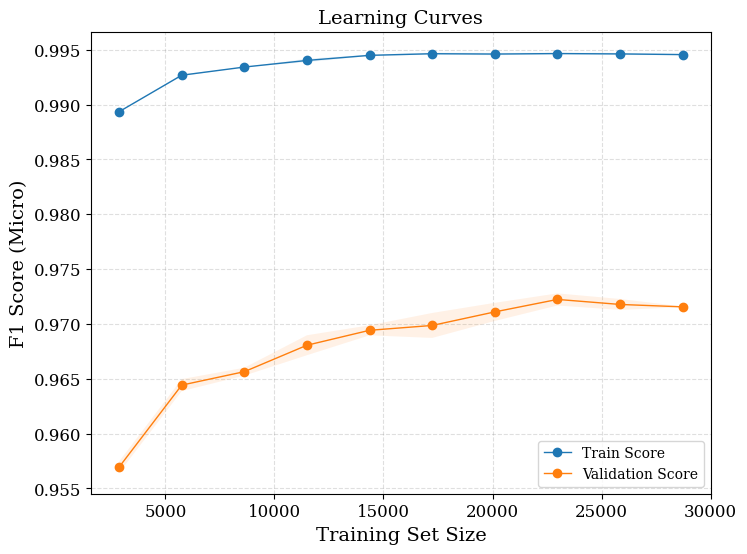

In [315]:
# Получение кривых обучения
train_sizes_xgb, train_scores_xgb, test_scores_xgb = learning_curve(
    best_model_xgb, X_train_xgb, y_train_xgb,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=3, scoring='f1_micro', n_jobs=-1
)

# Средние и стандартные отклонения
train_scores_mean_xgb = np.mean(train_scores_xgb, axis=1)
train_scores_std_xgb = np.std(train_scores_xgb, axis=1)
test_scores_mean_xgb = np.mean(test_scores_xgb, axis=1)
test_scores_std_xgb = np.std(test_scores_xgb, axis=1)

# Построение графика
plt.figure(figsize=(8, 6))
plt.plot(train_sizes_xgb, train_scores_mean_xgb, label="Train Score", marker='o')
plt.fill_between(train_sizes_xgb, train_scores_mean_xgb - train_scores_std_xgb, train_scores_mean_xgb + train_scores_std_xgb, alpha=0.1)
plt.plot(train_sizes_xgb, test_scores_mean_xgb, label="Validation Score", marker='o')
plt.fill_between(train_sizes_xgb, test_scores_mean_xgb - test_scores_std_xgb, test_scores_mean_xgb + test_scores_std_xgb, alpha=0.1)

plt.title("Learning Curves")
plt.xlabel("Training Set Size")
plt.ylabel("F1 Score (Micro)")
plt.legend(loc="best")
plt.grid()
plt.show()

Feature Importance for Variability Type:
                       Feature  Importance
12                period_final    0.327940
11  is_mean_cycle_period_final    0.151982
2                     parallax    0.133616
7                        bp_rp    0.106111
8                         bp_g    0.049186
6              phot_g_mean_mag    0.046992
9                         g_rp    0.043044
5                           pm    0.033654
13                       R_gal    0.031615
1                          BII    0.028100
0                          LII    0.021311
3                         pmra    0.013366
4                        pmdec    0.013083
10       is_bound_period_final    0.000000


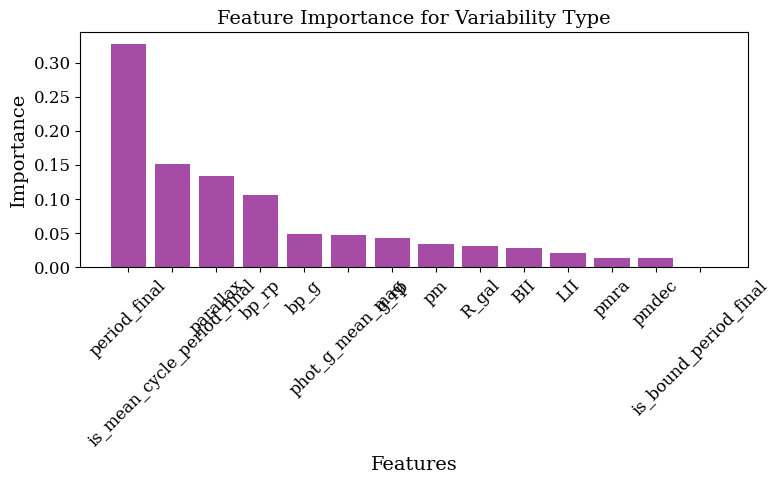

In [316]:
# Получение важности признаков
feature_importance_var_xgb = pd.DataFrame({
    'Feature': ['LII', 'BII', 'parallax', 'pmra', 'pmdec', 'pm',
       'phot_g_mean_mag', 'bp_rp', 'bp_g', 'g_rp', 'is_bound_period_final',
       'is_mean_cycle_period_final', 'period_final','R_gal'],
    'Importance': best_model_xgb.feature_importances_
}).sort_values(by='Importance', ascending=False)

# Вывод важности признаков
print("Feature Importance for Variability Type:")
print(feature_importance_var_xgb)

# Визуализация важности признаков
plt.figure(figsize=(8, 5))
plt.bar(feature_importance_var_xgb['Feature'], feature_importance_var_xgb['Importance'], color='purple', alpha=0.7)
plt.title('Feature Importance for Variability Type')
plt.ylabel('Importance')
plt.xlabel('Features')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [317]:
# Сохранение модели
dump(best_model_xgb, 'xgboost_model_full.joblib')

# Загрузка модели
#loaded_model = load('xgboost_model.joblib')

# Использование загруженной модели для предсказаний
#y_pred = loaded_model.predict(X_test_xgb)

['xgboost_model_full.joblib']

### Reduce data 

In [319]:
X_var_cut = X_var[['LII', 'BII', 'parallax',  'pm',
       'phot_g_mean_mag', 'bp_rp', 'bp_g', 'g_rp', 
       'is_mean_cycle_period_final', 'period_final']]

In [320]:
# Делим данные на тренировочные и тестовые
X_train_xgb_cut, X_test_xgb_cut, y_train_xgb_cut, y_test_xgb_cut = train_test_split(X_var_cut, y_var, test_size=0.2, random_state=42)

In [321]:
from sklearn.utils.class_weight import compute_class_weight
import numpy as np

# Преобразуем многометочную задачу в веса для каждого класса
class_weights_xgb_cut = []
for i in range(y_train_xgb_cut.shape[1]):  # Для каждой метки
    weights = compute_class_weight(
        class_weight="balanced",
        classes=np.array([0, 1]),
        y=y_train_xgb_cut[:, i]
    )
    class_weights_xgb_cut.append(weights)

# Генерируем sample_weight для всех образцов
sample_weights_xgb_cut = np.zeros(y_train_xgb_cut.shape[0])
for i in range(y_train_xgb_cut.shape[1]):
    sample_weights_xgb_cut += np.where(
        y_train_xgb_cut[:, i] == 1, class_weights_xgb_cut[i][1], class_weights_xgb_cut[i][0]
)

In [322]:
sample_weights_xgb_cut

array([14.10831924, 20.98612619, 20.98612619, ..., 48.63519189,
       14.10831924, 14.10831924])

In [323]:
# Определение целевой функции для Optuna
def objective_xgb_cut(trial):
    # Гиперпараметры для настройки
    param_xgb_cut = {
        "objective": "binary:logistic",
        "n_estimators": trial.suggest_int("n_estimators", 50, 200),
        "max_depth": trial.suggest_int("max_depth", 4, 8),
        "subsample": trial.suggest_float("subsample", 0.6, 0.8),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, .8),
        "lambda": trial.suggest_loguniform("lambda", 5, 10.0),  # L2-регуляризация
        "alpha": trial.suggest_loguniform("alpha", 2, 10.0),    # L1-регуляризация
        "random_state": 42
    }

    # Модель XGBoost
    model_xgb_cut = XGBClassifier(**param_xgb_cut)
    model_xgb_cut.fit(X_train_xgb_cut, y_train_xgb_cut, sample_weight=sample_weights_xgb_cut)

    # Оценка F1 (micro) на тестовых данных
    y_pred_xgb_cut = model_xgb_cut.predict(X_test_xgb_cut)
    return f1_score(y_test_xgb_cut, y_pred_xgb_cut, average="micro")

# Отслеживание времени начала
start_time_xgb_cut = time.time()

# Создание и запуск Optuna-исследования
study_xgb_cut = optuna.create_study(direction="maximize")
study_xgb_cut.optimize(objective_xgb_cut, n_trials=50)

# Отслеживание времени завершения
end_time_xgb_cut = time.time()

[I 2025-01-09 15:37:24,423] A new study created in memory with name: no-name-c1d0924b-8389-46f0-b2bf-239080d48fa3
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/4292128862.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda": trial.suggest_loguniform("lambda", 5, 10.0),  # L2-регуляризация
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/4292128862.py:11: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "alpha": trial.suggest_loguniform("alpha", 2, 10.0),    # L1-регуляризация
[I 2025-01-09 15:37:26,572] Trial 0 finished with value: 0.9731434070812928 and parameters: {'n_estimators': 93, 'max_depth': 6, 'subsample': 0.66217251034505

In [324]:
# Лучшие параметры
best_params_xgb_cut = study_xgb_cut.best_params
print("\nЛучшие параметры:", best_params_xgb_cut)
print("Лучший F1 (Micro):", study_xgb_cut.best_value)

# Время выполнения
execution_time_xgb_cut = end_time_xgb_cut - start_time_xgb_cut
print(f"\nВремя выполнения: {execution_time_xgb_cut:.2f} секунд ({execution_time_xgb_cut / 60:.2f} минут)")

# Обучение финальной модели с лучшими параметрами
best_model_xgb_cut = XGBClassifier(**best_params_xgb_cut, random_state=42)
best_model_xgb_cut.fit(X_train_xgb_cut, y_train_xgb_cut)

# Оценка модели
y_train_pred_xgb_cut = best_model_xgb_cut.predict(X_train_xgb_cut)
y_test_pred_xgb_cut = best_model_xgb_cut.predict(X_test_xgb_cut)

hamming_train_xgb_cut = hamming_loss(y_train_xgb_cut, y_train_pred_xgb_cut)
f1_micro_train_xgb_cut = f1_score(y_train_xgb_cut, y_train_pred_xgb_cut, average="micro")
f1_macro_train_xgb_cut = f1_score(y_train_xgb_cut, y_train_pred_xgb_cut, average="macro")
roc_auc_micro_train_xgb_cut = roc_auc_score(y_train_xgb_cut, best_model_xgb_cut.predict_proba(X_train_xgb_cut), average="micro", multi_class="ovr")

hamming_test_xgb_cut = hamming_loss(y_test_xgb_cut, y_test_pred_xgb_cut)
f1_micro_test_xgb_cut = f1_score(y_test_xgb_cut, y_test_pred_xgb_cut, average="micro")
f1_macro_test_xgb_cut = f1_score(y_test_xgb_cut, y_test_pred_xgb_cut, average="macro")
roc_auc_micro_test_xgb_cut = roc_auc_score(y_test_xgb_cut, best_model_xgb_cut.predict_proba(X_test_xgb_cut), average="micro", multi_class="ovr")
# Точность на тренировочных данных
accuracy_train_xgb_cut = accuracy_score(y_train_xgb_cut, y_train_pred_xgb_cut)

# Точность на тестовых данных
accuracy_test_xgb_cut = accuracy_score(y_test_xgb_cut, y_test_pred_xgb_cut)


# Вывод результатов
print("\nОценка модели:")
print(f"Hamming Loss (Train): {hamming_train_xgb_cut:.4f}")
print(f"Hamming Loss (Test): {hamming_test_xgb_cut:.4f}")
print(f"F1 Score Micro (Train): {f1_micro_train_xgb_cut:.4f}")
print(f"F1 Score Micro (Test): {f1_micro_test_xgb_cut:.4f}")
print(f"F1 Score Macro (Train): {f1_macro_train_xgb_cut:.4f}")
print(f"F1 Score Macro (Test): {f1_macro_test_xgb_cut:.4f}")
print(f"ROC-AUC Micro (Train): {roc_auc_micro_train_xgb_cut:.4f}")
print(f"ROC-AUC Micro (Test): {roc_auc_micro_test_xgb_cut:.4f}")
print(f"Accuracy (Train): {accuracy_train_xgb_cut:.4f}")
print(f"Accuracy (Test): {accuracy_test_xgb_cut:.4f}")


Лучшие параметры: {'n_estimators': 186, 'max_depth': 8, 'subsample': 0.7784066354409659, 'colsample_bytree': 0.6273884106583159, 'lambda': 6.012172100595309, 'alpha': 5.686838075822687}
Лучший F1 (Micro): 0.9761014451897044

Время выполнения: 209.78 секунд (3.50 минут)

Оценка модели:
Hamming Loss (Train): 0.0070
Hamming Loss (Test): 0.0182
F1 Score Micro (Train): 0.9903
F1 Score Micro (Test): 0.9750
F1 Score Macro (Train): 0.9496
F1 Score Macro (Test): 0.8756
ROC-AUC Micro (Train): 0.9997
ROC-AUC Micro (Test): 0.9980
Accuracy (Train): 0.9619
Accuracy (Test): 0.9131


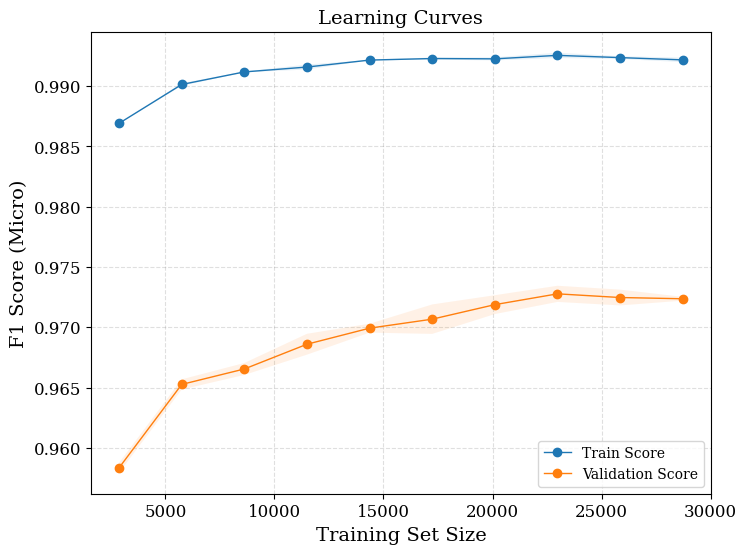

In [325]:
# Получение кривых обучения
train_sizes_xgb_cut, train_scores_xgb_cut, test_scores_xgb_cut = learning_curve(
    best_model_xgb, X_train_xgb_cut, y_train_xgb_cut,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=3, scoring='f1_micro', n_jobs=-1
)

# Средние и стандартные отклонения
train_scores_mean_xgb_cut = np.mean(train_scores_xgb_cut, axis=1)
train_scores_std_xgb_cut = np.std(train_scores_xgb_cut, axis=1)
test_scores_mean_xgb_cut = np.mean(test_scores_xgb_cut, axis=1)
test_scores_std_xgb_cut = np.std(test_scores_xgb_cut, axis=1)

# Построение графика
plt.figure(figsize=(8, 6))
plt.plot(train_sizes_xgb_cut, train_scores_mean_xgb_cut, label="Train Score", marker='o')
plt.fill_between(train_sizes_xgb_cut, train_scores_mean_xgb_cut - train_scores_std_xgb_cut, train_scores_mean_xgb_cut + train_scores_std_xgb_cut, alpha=0.1)
plt.plot(train_sizes_xgb_cut, test_scores_mean_xgb_cut, label="Validation Score", marker='o')
plt.fill_between(train_sizes_xgb_cut, test_scores_mean_xgb_cut - test_scores_std_xgb_cut, test_scores_mean_xgb_cut + test_scores_std_xgb_cut, alpha=0.1)

plt.title("Learning Curves")
plt.xlabel("Training Set Size")
plt.ylabel("F1 Score (Micro)")
plt.legend(loc="best")
plt.grid()
plt.show()

Feature Importance for Variability Type:
                      Feature  Importance
9                period_final    0.374677
8  is_mean_cycle_period_final    0.133655
2                    parallax    0.125094
5                       bp_rp    0.100511
7                        g_rp    0.055742
6                        bp_g    0.054441
4             phot_g_mean_mag    0.052707
1                         BII    0.036536
3                          pm    0.033336
0                         LII    0.033300


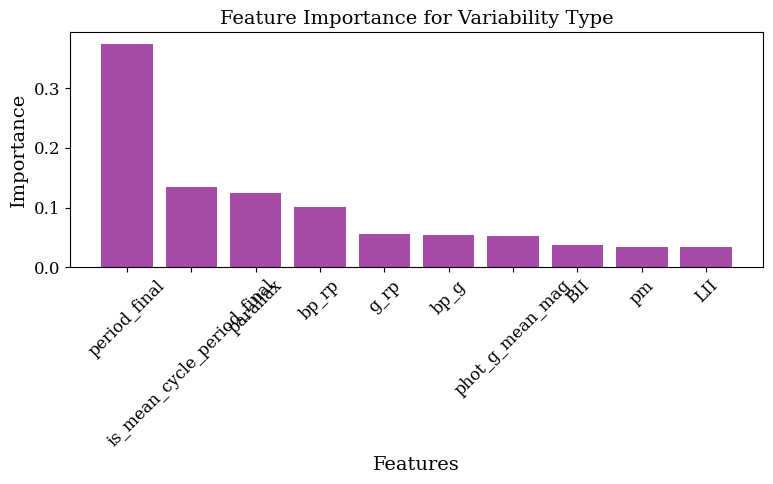

In [326]:
# Получение важности признаков
feature_importance_var = pd.DataFrame({
    'Feature': ['LII', 'BII', 'parallax',  'pm',
       'phot_g_mean_mag', 'bp_rp', 'bp_g', 'g_rp', 
       'is_mean_cycle_period_final', 'period_final'],
    'Importance': best_model_xgb_cut.feature_importances_
}).sort_values(by='Importance', ascending=False)

# Вывод важности признаков
print("Feature Importance for Variability Type:")
print(feature_importance_var)

# Визуализация важности признаков
plt.figure(figsize=(8, 5))
plt.bar(feature_importance_var['Feature'], feature_importance_var['Importance'], color='purple', alpha=0.7)
plt.title('Feature Importance for Variability Type')
plt.ylabel('Importance')
plt.xlabel('Features')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [327]:
# Сохранение модели
dump(best_model_xgb_cut, 'xgboost_model_cut.joblib')

# Загрузка модели
#loaded_model = load('xgboost_model.joblib')

# Использование загруженной модели для предсказаний
#y_pred = loaded_model.predict(X_test_xgb)

['xgboost_model_cut.joblib']

## Random Forest

In [329]:
# Делим данные на тренировочные и тестовые
X_train_rf, X_test_rf, y_train_rf, y_test_rf = train_test_split(
    X_var, y_var, test_size=0.2, random_state=42
)

# Преобразуем многометочную задачу в веса для каждого класса
class_weights_rf = []
for i in range(y_train_rf.shape[1]):  # Для каждой метки
    weights_rf = compute_class_weight(
        class_weight="balanced",
        classes=np.array([0, 1]),
        y=y_train_rf[:, i]
    )
    class_weights_rf.append(weights_rf)

# Генерируем sample_weight для всех образцов
sample_weights_rf = np.zeros(y_train_rf.shape[0])
for i in range(y_train_rf.shape[1]):
    sample_weights_rf += np.where(
        y_train_rf[:, i] == 1, class_weights_rf[i][1], class_weights_rf[i][0]
)

In [330]:
print(X_var.isna().sum())

LII                           0
BII                           0
parallax                      0
pmra                          0
pmdec                         0
pm                            0
phot_g_mean_mag               0
bp_rp                         0
bp_g                          0
g_rp                          0
is_bound_period_final         0
is_mean_cycle_period_final    0
period_final                  0
R_gal                         0
dtype: int64


In [331]:
# Определение целевой функции для Optuna
def objective_rf(trial):
    # Гиперпараметры для настройки
    param_rf = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 200),
        "max_depth": trial.suggest_int("max_depth", 4, 10),
        "min_samples_split": trial.suggest_int("min_samples_split", 2, 10),
        "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 5),
        "max_features": trial.suggest_categorical("max_features", ["sqrt", "log2", None]),
        "random_state": 42
    }

    # Модель Random Forest
    model_rf = RandomForestClassifier(**param_rf)
    model_rf.fit(X_train_rf, y_train_rf, sample_weight=sample_weights_rf)

    # Оценка F1 (micro) на тестовых данных
    y_pred_rf = model_rf.predict(X_test_rf)
    return f1_score(y_test_rf, y_pred_rf, average="micro")

# Отслеживание времени начала
start_time_rf = time.time()

# Создание и запуск Optuna-исследования
study_rf = optuna.create_study(direction="maximize")
study_rf.optimize(objective_rf, n_trials=50)

# Отслеживание времени завершения
end_time_rf = time.time()

[I 2025-01-09 15:41:35,975] A new study created in memory with name: no-name-2b8f8d14-d8ec-4d32-860d-4461f1f075f0
[I 2025-01-09 15:42:01,694] Trial 0 finished with value: 0.9487201356091217 and parameters: {'n_estimators': 171, 'max_depth': 9, 'min_samples_split': 9, 'min_samples_leaf': 1, 'max_features': 'sqrt'}. Best is trial 0 with value: 0.9487201356091217.
[I 2025-01-09 15:42:09,115] Trial 1 finished with value: 0.9363347559605942 and parameters: {'n_estimators': 56, 'max_depth': 7, 'min_samples_split': 6, 'min_samples_leaf': 5, 'max_features': 'sqrt'}. Best is trial 0 with value: 0.9487201356091217.
[I 2025-01-09 15:42:54,349] Trial 2 finished with value: 0.9396434490671881 and parameters: {'n_estimators': 151, 'max_depth': 5, 'min_samples_split': 2, 'min_samples_leaf': 4, 'max_features': None}. Best is trial 0 with value: 0.9487201356091217.
[I 2025-01-09 15:43:11,212] Trial 3 finished with value: 0.9269927681263844 and parameters: {'n_estimators': 65, 'max_depth': 4, 'min_sampl

In [332]:
# Лучшие параметры
best_params_rf = study_rf.best_params
print("\nЛучшие параметры:", best_params_rf)
print("Лучший F1 (Micro):", study_rf.best_value)

# Время выполнения
execution_time_rf = end_time_rf - start_time_rf
print(f"\nВремя выполнения: {execution_time_rf:.2f} секунд ({execution_time_rf / 60:.2f} минут)")

# Обучение финальной модели с лучшими параметрами
best_model_rf = RandomForestClassifier(**best_params_rf, random_state=42)
best_model_rf.fit(X_train_rf, y_train_rf)

# Оценка модели
y_train_pred_rf = best_model_rf.predict(X_train_rf)
y_test_pred_rf = best_model_rf.predict(X_test_rf)

hamming_train_rf = hamming_loss(y_train_rf, y_train_pred_rf)
f1_micro_train_rf = f1_score(y_train_rf, y_train_pred_rf, average="micro")
f1_macro_train_rf = f1_score(y_train_rf, y_train_pred_rf, average="macro")

hamming_test_rf = hamming_loss(y_test_rf, y_test_pred_rf)
f1_micro_test_rf = f1_score(y_test_rf, y_test_pred_rf, average="micro")
f1_macro_test_rf = f1_score(y_test_rf, y_test_pred_rf, average="macro")

accuracy_train_rf = accuracy_score(y_train_rf, y_train_pred_rf)
accuracy_test_rf = accuracy_score(y_test_rf, y_test_pred_rf)

# Вывод результатов
print(f"\nВремя выполнения: {execution_time_rf:.2f} секунд ({execution_time_rf / 60:.2f} минут)")
print("\nОценка модели:")
print(f"Hamming Loss (Train): {hamming_train_rf:.4f}")
print(f"Hamming Loss (Test): {hamming_test_rf:.4f}")
print(f"F1 Score Micro (Train): {f1_micro_train_rf:.4f}")
print(f"F1 Score Micro (Test): {f1_micro_test_rf:.4f}")
print(f"F1 Score Macro (Train): {f1_macro_train_rf:.4f}")
print(f"F1 Score Macro (Test): {f1_macro_test_rf:.4f}")
print(f"Accuracy (Train): {accuracy_train_rf:.4f}")
print(f"Accuracy (Test): {accuracy_test_rf:.4f}")


Лучшие параметры: {'n_estimators': 88, 'max_depth': 10, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': None}
Лучший F1 (Micro): 0.966054387410617

Время выполнения: 2488.94 секунд (41.48 минут)

Время выполнения: 2488.94 секунд (41.48 минут)

Оценка модели:
Hamming Loss (Train): 0.0177
Hamming Loss (Test): 0.0220
F1 Score Micro (Train): 0.9757
F1 Score Micro (Test): 0.9697
F1 Score Macro (Train): 0.8856
F1 Score Macro (Test): 0.8579
Accuracy (Train): 0.9353
Accuracy (Test): 0.9199


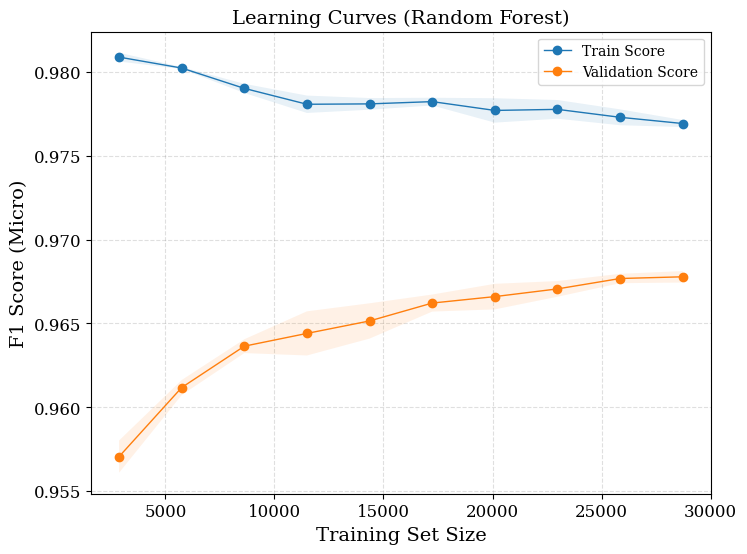

In [333]:
# Кривые обучения
train_sizes_rf, train_scores_rf, test_scores_rf = learning_curve(
    best_model_rf, X_train_rf, y_train_rf,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=3, scoring='f1_micro', n_jobs=-1
)

# Средние и стандартные отклонения
train_scores_mean_rf = np.mean(train_scores_rf, axis=1)
train_scores_std_rf = np.std(train_scores_rf, axis=1)
test_scores_mean_rf = np.mean(test_scores_rf, axis=1)
test_scores_std_rf = np.std(test_scores_rf, axis=1)

# Построение графика
plt.figure(figsize=(8, 6))
plt.plot(train_sizes_rf, train_scores_mean_rf, label="Train Score", marker='o')
plt.fill_between(train_sizes_rf, train_scores_mean_rf - train_scores_std_rf, train_scores_mean_rf + train_scores_std_rf, alpha=0.1)
plt.plot(train_sizes_rf, test_scores_mean_rf, label="Validation Score", marker='o')
plt.fill_between(train_sizes_rf, test_scores_mean_rf - test_scores_std_rf, test_scores_mean_rf + test_scores_std_rf, alpha=0.1)

plt.title("Learning Curves (Random Forest)")
plt.xlabel("Training Set Size")
plt.ylabel("F1 Score (Micro)")
plt.legend(loc="best")
plt.grid()
plt.show()

Feature Importance for Variability Type (Random Forest):
                       Feature  Importance
12                period_final    0.684249
2                     parallax    0.162670
6              phot_g_mean_mag    0.041885
7                        bp_rp    0.035679
8                         bp_g    0.019089
9                         g_rp    0.014381
5                           pm    0.010017
13                       R_gal    0.007904
1                          BII    0.007759
0                          LII    0.006682
11  is_mean_cycle_period_final    0.004633
4                        pmdec    0.002680
3                         pmra    0.002373
10       is_bound_period_final    0.000000


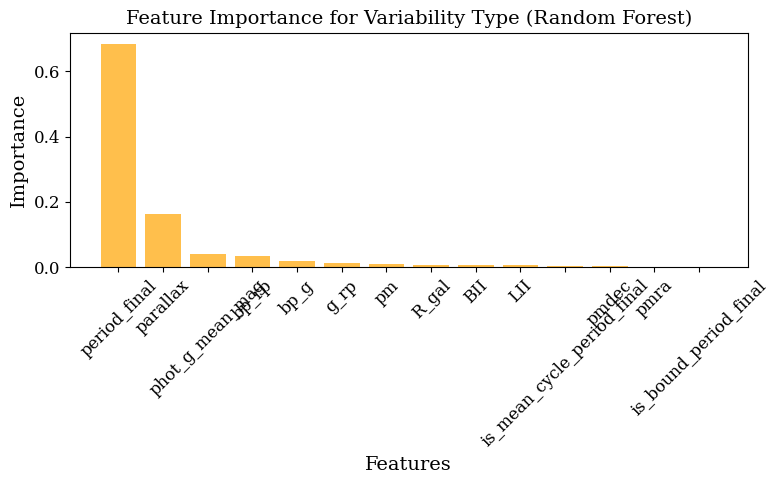

['random_forest_model_full.joblib']

In [334]:
# Важность признаков
feature_importance_var_rf = pd.DataFrame({
    'Feature': ['LII', 'BII', 'parallax', 'pmra', 'pmdec', 'pm',
       'phot_g_mean_mag', 'bp_rp', 'bp_g', 'g_rp', 'is_bound_period_final',
       'is_mean_cycle_period_final', 'period_final','R_gal'],
    'Importance': best_model_rf.feature_importances_
}).sort_values(by='Importance', ascending=False)

# Вывод важности признаков
print("Feature Importance for Variability Type (Random Forest):")
print(feature_importance_var_rf)

# Визуализация важности признаков
plt.figure(figsize=(8, 5))
plt.bar(feature_importance_var_rf['Feature'], feature_importance_var_rf['Importance'], color='orange', alpha=0.7)
plt.title('Feature Importance for Variability Type (Random Forest)')
plt.ylabel('Importance')
plt.xlabel('Features')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Сохранение модели
dump(best_model_rf, 'random_forest_model_full.joblib')

## Neural Networks

In [360]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from sklearn.metrics import hamming_loss, f1_score, accuracy_score
from optuna.integration import TFKerasPruningCallback
import optuna
import time
import numpy as np

In [362]:
# Разделение данных на тренировочные и тестовые
X_train_nn, X_test_nn, y_train_nn, y_test_nn = train_test_split(
    X_var, y_var, test_size=0.2, random_state=42
)

In [369]:
print("X_train_nn shape:", X_train_nn.shape)
print("y_train_nn shape:", y_train_nn.shape)
print("X_test_nn shape:", X_test_nn.shape)
print("y_test_nn shape:", y_test_nn.shape)

assert X_train_nn.shape[0] > 0, "X_train_nn is empty!"
assert X_test_nn.shape[0] > 0, "X_test_nn is empty!"
assert y_train_nn.shape[0] > 0, "y_train_nn is empty!"
assert y_test_nn.shape[0] > 0, "y_test_nn is empty!"

X_train_nn shape: (43088, 14)
y_train_nn shape: (43088, 24)
X_test_nn shape: (10772, 14)
y_test_nn shape: (10772, 24)


In [380]:
X_train_nn

,LII,BII,parallax,pmra,pmdec,pm,phot_g_mean_mag,bp_rp,bp_g,g_rp,is_bound_period_final,is_mean_cycle_period_final,period_final,R_gal
6407,274.64554,-0.79409,0.964581,-4.504216,1.941326,4.904764,13.972858,2.475006,1.225483,1.205369,0,0,2.653116,8.181558
219,310.08749,-21.69523,0.588338,-7.688773,-7.734044,10.905625,13.893970,1.204637,0.508727,0.695909,0,0,-0.033006,7.310961
33041,35.56289,15.92599,0.302588,-1.639178,3.995661,4.318821,15.346153,0.787793,0.300986,0.486807,0,0,-0.153112,5.980336
11337,355.14280,-6.77509,0.042942,1.006286,-7.007366,7.079251,12.911620,4.719554,3.062527,1.657027,0,0,2.324488,15.220428
37397,63.02546,-9.34191,1.456284,-0.335220,-1.697969,1.730743,7.033473,-0.116989,-0.056486,-0.060503,0,0,-0.033006,7.916508
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11284,2.46331,-23.79017,0.132851,-1.300324,-2.689174,2.987055,19.161346,2.475006,1.225483,1.205369,0,0,-0.364679,3.323611
44732,103.69696,-19.81374,0.169483,0.202131,-2.478134,2.486364,15.357537,0.694865,0.250676,0.444189,0,0,-0.331054,11.117993
38158,167.16547,-23.90199,7.272149,21.221602,-44.866874,49.632576,13.113663,1.585524,0.740640,0.844884,0,0,0.591105,8.322810
860,305.69764,-11.95869,6.135044,-5.730215,23.600220,24.285917,8.154426,0.624667,0.225445,0.399222,0,0,-0.432910,8.108058


In [390]:
y_train_nn.shape

(43088, 24)

In [392]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import f1_score

# Модель
def build_model(input_shape, output_shape, trial):
    model = Sequential()
    num_layers = trial.suggest_int("num_layers", 1, 3)  # Количество скрытых слоев

    for i in range(num_layers):
        units = trial.suggest_int(f"units_{i}", 64, 256, step=64)
        model.add(Dense(units, activation="relu", input_shape=(input_shape,) if i == 0 else ()))
        model.add(BatchNormalization())
        dropout_rate = trial.suggest_float(f"dropout_rate_{i}", 0.2, 0.5)
        model.add(Dropout(dropout_rate))

    model.add(Dense(output_shape, activation="sigmoid"))
    learning_rate = trial.suggest_float("learning_rate", 1e-4, 1e-2, log=True)
    optimizer = Adam(learning_rate=learning_rate)
    model.compile(optimizer=optimizer, loss="binary_crossentropy", metrics=["accuracy"])
    return model

# Optuna Objective Function
def objective_nn(trial):
    model = build_model(X_train_nn.shape[1], y_train_nn.shape[1], trial)
    model.fit(
        X_train_nn, y_train_nn,
        validation_data=(X_test_nn, y_test_nn),
        epochs=10,  # Уменьшаем количество эпох для быстрого тестирования
        batch_size=16,
        verbose=0
    )
    # Предсказания
    y_pred_nn = (model.predict(X_test_nn) > 0.5).astype(int)
    # Оценка F1 (micro)
    return f1_score(y_test_nn, y_pred_nn, average="micro")

# Optuna Study
import optuna
start_time = time.time()

study_nn = optuna.create_study(direction="maximize")
study_nn.optimize(objective_nn, n_trials=50)

end_time = time.time()

# Лучшие параметры
best_params_nn = study_nn.best_params
print("\nЛучшие параметры:", best_params_nn)
print(f"Лучший F1 (Micro): {study_nn.best_value:.4f}")
print(f"Время выполнения: {end_time - start_time:.2f} секунд ({(end_time - start_time) / 60:.2f} минут)")

[I 2025-01-10 13:50:38,794] A new study created in memory with name: no-name-03781613-e9f2-4566-93f4-ded63f939047


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 309us/step


[I 2025-01-10 13:50:50,392] Trial 0 finished with value: 0.8786021923263254 and parameters: {'num_layers': 1, 'units_0': 128, 'dropout_rate_0': 0.3506827501906803, 'learning_rate': 0.0032307140465619062}. Best is trial 0 with value: 0.8786021923263254.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 485us/step


[I 2025-01-10 13:51:18,908] Trial 1 finished with value: 0.9278480539122164 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.2627617475026006, 'units_1': 192, 'dropout_rate_1': 0.4332428843814184, 'units_2': 256, 'dropout_rate_2': 0.37301027540473797, 'learning_rate': 0.0022234440895686582}. Best is trial 1 with value: 0.9278480539122164.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 303us/step


[I 2025-01-10 13:51:30,985] Trial 2 finished with value: 0.894879369768587 and parameters: {'num_layers': 1, 'units_0': 192, 'dropout_rate_0': 0.20487948250112062, 'learning_rate': 0.0007838504574493118}. Best is trial 1 with value: 0.9278480539122164.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 490us/step


[I 2025-01-10 13:51:59,250] Trial 3 finished with value: 0.9240115090401482 and parameters: {'num_layers': 2, 'units_0': 256, 'dropout_rate_0': 0.3531626535635162, 'units_1': 256, 'dropout_rate_1': 0.3131921155836479, 'learning_rate': 0.0019711869698479335}. Best is trial 1 with value: 0.9278480539122164.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 571us/step


[I 2025-01-10 13:52:35,397] Trial 4 finished with value: 0.9147233117326057 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.2578288849944582, 'units_1': 256, 'dropout_rate_1': 0.4428107974167229, 'units_2': 256, 'dropout_rate_2': 0.4154330510065264, 'learning_rate': 0.0029810937075222745}. Best is trial 1 with value: 0.9278480539122164.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 403us/step


[I 2025-01-10 13:52:53,124] Trial 5 finished with value: 0.9244632126728195 and parameters: {'num_layers': 3, 'units_0': 128, 'dropout_rate_0': 0.3181813788124148, 'units_1': 64, 'dropout_rate_1': 0.24423776818984844, 'units_2': 128, 'dropout_rate_2': 0.20094295855858701, 'learning_rate': 0.0043723192555118725}. Best is trial 1 with value: 0.9278480539122164.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 306us/step


[I 2025-01-10 13:53:04,376] Trial 6 finished with value: 0.8935251951136749 and parameters: {'num_layers': 1, 'units_0': 128, 'dropout_rate_0': 0.308440040321353, 'learning_rate': 0.0005649212663521826}. Best is trial 1 with value: 0.9278480539122164.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 637us/step


[I 2025-01-10 13:53:34,676] Trial 7 finished with value: 0.9141976329277984 and parameters: {'num_layers': 3, 'units_0': 64, 'dropout_rate_0': 0.3502269127463193, 'units_1': 256, 'dropout_rate_1': 0.31402769682922665, 'units_2': 256, 'dropout_rate_2': 0.28733431189043557, 'learning_rate': 0.002142600218033229}. Best is trial 1 with value: 0.9278480539122164.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 426us/step


[I 2025-01-10 13:53:56,266] Trial 8 finished with value: 0.9136469392667077 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.452546084355561, 'units_1': 64, 'dropout_rate_1': 0.28374098745877185, 'units_2': 256, 'dropout_rate_2': 0.2688771196158883, 'learning_rate': 0.00973782345399956}. Best is trial 1 with value: 0.9278480539122164.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 400us/step


[I 2025-01-10 13:54:15,729] Trial 9 finished with value: 0.89574091218006 and parameters: {'num_layers': 3, 'units_0': 128, 'dropout_rate_0': 0.4427497598731767, 'units_1': 64, 'dropout_rate_1': 0.45536386495333847, 'units_2': 192, 'dropout_rate_2': 0.3953939595366594, 'learning_rate': 0.009748580942870263}. Best is trial 1 with value: 0.9278480539122164.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 425us/step


[I 2025-01-10 13:54:36,778] Trial 10 finished with value: 0.9093257501262392 and parameters: {'num_layers': 2, 'units_0': 256, 'dropout_rate_0': 0.20200320536946073, 'units_1': 192, 'dropout_rate_1': 0.39341262545717415, 'learning_rate': 0.00010277468084517943}. Best is trial 1 with value: 0.9278480539122164.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 346us/step


[I 2025-01-10 13:54:51,042] Trial 11 finished with value: 0.9136384685399179 and parameters: {'num_layers': 2, 'units_0': 64, 'dropout_rate_0': 0.2798518715103897, 'units_1': 128, 'dropout_rate_1': 0.209908753523178, 'learning_rate': 0.004077353361305372}. Best is trial 1 with value: 0.9278480539122164.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 413us/step


[I 2025-01-10 13:55:09,099] Trial 12 finished with value: 0.920961025093433 and parameters: {'num_layers': 3, 'units_0': 128, 'dropout_rate_0': 0.41075648402832116, 'units_1': 128, 'dropout_rate_1': 0.49786723469993943, 'units_2': 64, 'dropout_rate_2': 0.20065739539424265, 'learning_rate': 0.0003055490083695891}. Best is trial 1 with value: 0.9278480539122164.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 432us/step


[I 2025-01-10 13:55:33,107] Trial 13 finished with value: 0.9290292282815777 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.2566435637181812, 'units_1': 192, 'dropout_rate_1': 0.20974303306237205, 'units_2': 128, 'dropout_rate_2': 0.4949117484120681, 'learning_rate': 0.0012835813401165625}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 390us/step


[I 2025-01-10 13:55:54,073] Trial 14 finished with value: 0.9059109554563077 and parameters: {'num_layers': 2, 'units_0': 256, 'dropout_rate_0': 0.24110522892594968, 'units_1': 192, 'dropout_rate_1': 0.39491865936678405, 'learning_rate': 0.0012565981500184348}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 441us/step


[I 2025-01-10 13:56:18,632] Trial 15 finished with value: 0.924671358243542 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.24327249502489645, 'units_1': 192, 'dropout_rate_1': 0.3702488513399257, 'units_2': 128, 'dropout_rate_2': 0.4946867022721612, 'learning_rate': 0.0004911643224045387}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 384us/step


[I 2025-01-10 13:56:38,215] Trial 16 finished with value: 0.920180041015261 and parameters: {'num_layers': 2, 'units_0': 192, 'dropout_rate_0': 0.2959587911563867, 'units_1': 192, 'dropout_rate_1': 0.4348690569437007, 'learning_rate': 0.0011881855312600373}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 446us/step


[I 2025-01-10 13:57:02,567] Trial 17 finished with value: 0.9184216715486091 and parameters: {'num_layers': 3, 'units_0': 256, 'dropout_rate_0': 0.3997646159894755, 'units_1': 128, 'dropout_rate_1': 0.21413593377676532, 'units_2': 192, 'dropout_rate_2': 0.48232748275123316, 'learning_rate': 0.00025843910155640945}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 378us/step


[I 2025-01-10 13:57:21,716] Trial 18 finished with value: 0.9124173409728096 and parameters: {'num_layers': 2, 'units_0': 192, 'dropout_rate_0': 0.26915787620369264, 'units_1': 192, 'dropout_rate_1': 0.33238739905693226, 'learning_rate': 0.001742968882430282}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 457us/step


[I 2025-01-10 13:57:44,653] Trial 19 finished with value: 0.9241760651126476 and parameters: {'num_layers': 3, 'units_0': 256, 'dropout_rate_0': 0.22853840287021138, 'units_1': 128, 'dropout_rate_1': 0.2751475397397753, 'units_2': 64, 'dropout_rate_2': 0.4233135878865577, 'learning_rate': 0.000802265024007375}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 476us/step


[I 2025-01-10 13:58:12,337] Trial 20 finished with value: 0.9201299536798765 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.32511433286693037, 'units_1': 256, 'dropout_rate_1': 0.4910291597224813, 'units_2': 128, 'dropout_rate_2': 0.3524051297500874, 'learning_rate': 0.006257883842764431}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 475us/step


[I 2025-01-10 13:58:38,715] Trial 21 finished with value: 0.9223555210185116 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.23764815671919892, 'units_1': 192, 'dropout_rate_1': 0.3748740872341788, 'units_2': 128, 'dropout_rate_2': 0.4954032741252961, 'learning_rate': 0.0004439609465185727}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 458us/step


[I 2025-01-10 13:59:05,488] Trial 22 finished with value: 0.9147491108540087 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.25736396087178054, 'units_1': 192, 'dropout_rate_1': 0.36557893204846614, 'units_2': 192, 'dropout_rate_2': 0.4613700336725351, 'learning_rate': 0.00017777217213391783}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step


[I 2025-01-10 13:59:29,729] Trial 23 finished with value: 0.920810037184666 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.4969988781738146, 'units_1': 192, 'dropout_rate_1': 0.4101203073228926, 'units_2': 128, 'dropout_rate_2': 0.4574487925471001, 'learning_rate': 0.000533979968934941}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 426us/step


[I 2025-01-10 13:59:51,182] Trial 24 finished with value: 0.9193570809851247 and parameters: {'num_layers': 3, 'units_0': 128, 'dropout_rate_0': 0.2221687805278839, 'units_1': 192, 'dropout_rate_1': 0.36290409944642116, 'units_2': 128, 'dropout_rate_2': 0.3607262966253727, 'learning_rate': 0.0013630661758876545}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 344us/step


[I 2025-01-10 14:00:07,300] Trial 25 finished with value: 0.9230802002343167 and parameters: {'num_layers': 2, 'units_0': 192, 'dropout_rate_0': 0.2818169552233881, 'units_1': 128, 'dropout_rate_1': 0.42627682835858527, 'learning_rate': 0.0009844641853431137}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 477us/step


[I 2025-01-10 14:00:39,778] Trial 26 finished with value: 0.9252626259939896 and parameters: {'num_layers': 3, 'units_0': 256, 'dropout_rate_0': 0.25158450926235354, 'units_1': 256, 'dropout_rate_1': 0.3416182403349671, 'units_2': 64, 'dropout_rate_2': 0.30375681985075653, 'learning_rate': 0.000386666872773518}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 487us/step


[I 2025-01-10 14:01:12,979] Trial 27 finished with value: 0.923637488796893 and parameters: {'num_layers': 3, 'units_0': 256, 'dropout_rate_0': 0.29460158864643515, 'units_1': 256, 'dropout_rate_1': 0.24060710782747047, 'units_2': 64, 'dropout_rate_2': 0.30812175434996125, 'learning_rate': 0.00033457072922583067}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 419us/step


[I 2025-01-10 14:01:40,677] Trial 28 finished with value: 0.9218613570743676 and parameters: {'num_layers': 2, 'units_0': 256, 'dropout_rate_0': 0.33409469884695586, 'units_1': 256, 'dropout_rate_1': 0.3375048718592986, 'learning_rate': 0.00021378783818692775}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 296us/step


[I 2025-01-10 14:01:52,504] Trial 29 finished with value: 0.9010261467523121 and parameters: {'num_layers': 1, 'units_0': 256, 'dropout_rate_0': 0.37642938598182685, 'learning_rate': 0.002579302314832692}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 384us/step


[I 2025-01-10 14:02:11,384] Trial 30 finished with value: 0.9109338970023059 and parameters: {'num_layers': 3, 'units_0': 64, 'dropout_rate_0': 0.21860690072340425, 'units_1': 256, 'dropout_rate_1': 0.47179918331067605, 'units_2': 64, 'dropout_rate_2': 0.3224083559767822, 'learning_rate': 0.00013918076673270029}. Best is trial 13 with value: 0.9290292282815777.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 420us/step


[I 2025-01-10 14:02:38,611] Trial 31 finished with value: 0.9300773239917978 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.2542319349823189, 'units_1': 192, 'dropout_rate_1': 0.287532302822155, 'units_2': 192, 'dropout_rate_2': 0.24943994963001648, 'learning_rate': 0.0004123556706449186}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 446us/step


[I 2025-01-10 14:03:05,450] Trial 32 finished with value: 0.9293755632942783 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.2601148773792581, 'units_1': 192, 'dropout_rate_1': 0.28294997856948934, 'units_2': 192, 'dropout_rate_2': 0.24547773179396915, 'learning_rate': 0.0004155992658675125}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 423us/step


[I 2025-01-10 14:03:31,880] Trial 33 finished with value: 0.917920591010122 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.2680168002371004, 'units_1': 192, 'dropout_rate_1': 0.2794787185727459, 'units_2': 192, 'dropout_rate_2': 0.23986833579316433, 'learning_rate': 0.0007054423768599339}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 419us/step


[I 2025-01-10 14:03:57,954] Trial 34 finished with value: 0.9131481521111089 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.2938678919509263, 'units_1': 192, 'dropout_rate_1': 0.30080131670526794, 'units_2': 192, 'dropout_rate_2': 0.24620378874254212, 'learning_rate': 0.0016941371769243333}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 442us/step


[I 2025-01-10 14:04:26,463] Trial 35 finished with value: 0.924688135538937 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.21091654321267406, 'units_1': 192, 'dropout_rate_1': 0.2540892446621984, 'units_2': 256, 'dropout_rate_2': 0.2414246444758738, 'learning_rate': 0.0007811118770468033}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 329us/step


[I 2025-01-10 14:11:39,499] Trial 36 finished with value: 0.9256041531196368 and parameters: {'num_layers': 2, 'units_0': 128, 'dropout_rate_0': 0.26847602082493016, 'units_1': 128, 'dropout_rate_1': 0.2244391019935721, 'learning_rate': 0.0009509825215167311}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 460us/step


[I 2025-01-10 14:14:38,243] Trial 37 finished with value: 0.9292665508383342 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.313083234348014, 'units_1': 192, 'dropout_rate_1': 0.2605542791843075, 'units_2': 192, 'dropout_rate_2': 0.3844283398888808, 'learning_rate': 0.0006213868685488008}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 506us/step


[I 2025-01-10 14:15:05,156] Trial 38 finished with value: 0.9234492258761083 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.3108839609166101, 'units_1': 192, 'dropout_rate_1': 0.2601273289458432, 'units_2': 192, 'dropout_rate_2': 0.263936615445431, 'learning_rate': 0.0006307786274955436}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 310us/step


[I 2025-01-10 14:15:16,431] Trial 39 finished with value: 0.8957386046363216 and parameters: {'num_layers': 1, 'units_0': 128, 'dropout_rate_0': 0.33679679363884596, 'learning_rate': 0.00024641127155887444}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 520us/step


[I 2025-01-10 14:15:37,631] Trial 40 finished with value: 0.9030027434326733 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.2816840078250921, 'units_1': 128, 'dropout_rate_1': 0.3049324091224545, 'units_2': 192, 'dropout_rate_2': 0.43315874834388435, 'learning_rate': 0.00038697121684576536}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 448us/step


[I 2025-01-10 14:16:03,780] Trial 41 finished with value: 0.9199432054744799 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.25295121797657105, 'units_1': 192, 'dropout_rate_1': 0.22914226774630622, 'units_2': 192, 'dropout_rate_2': 0.38633860553802535, 'learning_rate': 0.002304552624043375}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 483us/step


[I 2025-01-10 14:16:31,965] Trial 42 finished with value: 0.9155425376115031 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.30573701680185245, 'units_1': 192, 'dropout_rate_1': 0.2004376303112288, 'units_2': 256, 'dropout_rate_2': 0.3760591151199355, 'learning_rate': 0.0036276575035151352}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 547us/step


[I 2025-01-10 14:16:58,448] Trial 43 finished with value: 0.8962690907524287 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.36335629208893366, 'units_1': 192, 'dropout_rate_1': 0.31892679402188456, 'units_2': 192, 'dropout_rate_2': 0.33575484778390263, 'learning_rate': 0.000644073522166045}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 466us/step


[I 2025-01-10 14:17:26,695] Trial 44 finished with value: 0.9186389899422213 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.2302693485244983, 'units_1': 192, 'dropout_rate_1': 0.2643162993178336, 'units_2': 256, 'dropout_rate_2': 0.2234510843029296, 'learning_rate': 0.001433802751360641}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 542us/step


[I 2025-01-10 14:18:00,397] Trial 45 finished with value: 0.9107291911906341 and parameters: {'num_layers': 3, 'units_0': 128, 'dropout_rate_0': 0.26651092620866096, 'units_1': 256, 'dropout_rate_1': 0.28817039644708053, 'units_2': 256, 'dropout_rate_2': 0.4068616921367619, 'learning_rate': 0.002736880562998541}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 550us/step


[I 2025-01-10 14:18:26,598] Trial 46 finished with value: 0.9247963467786249 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.2840432435986531, 'units_1': 192, 'dropout_rate_1': 0.23652437995745773, 'units_2': 192, 'dropout_rate_2': 0.3714464932633238, 'learning_rate': 0.005334574876190293}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 427us/step


[I 2025-01-10 14:18:47,143] Trial 47 finished with value: 0.9143206460538593 and parameters: {'num_layers': 3, 'units_0': 128, 'dropout_rate_0': 0.24695019803605203, 'units_1': 192, 'dropout_rate_1': 0.29312244721714753, 'units_2': 128, 'dropout_rate_2': 0.44044284567751807, 'learning_rate': 0.0010998802668540576}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 479us/step


[I 2025-01-10 14:19:04,588] Trial 48 finished with value: 0.9262669369465485 and parameters: {'num_layers': 2, 'units_0': 192, 'dropout_rate_0': 0.2090032556226874, 'units_1': 128, 'dropout_rate_1': 0.24904014250299691, 'learning_rate': 0.0009089857955514986}. Best is trial 31 with value: 0.9300773239917978.


337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 427us/step


[I 2025-01-10 14:19:31,882] Trial 49 finished with value: 0.9271473662285503 and parameters: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.3239686169063808, 'units_1': 192, 'dropout_rate_1': 0.3155870628749939, 'units_2': 192, 'dropout_rate_2': 0.2796268606544658, 'learning_rate': 0.00043859184236350664}. Best is trial 31 with value: 0.9300773239917978.



Лучшие параметры: {'num_layers': 3, 'units_0': 192, 'dropout_rate_0': 0.2542319349823189, 'units_1': 192, 'dropout_rate_1': 0.287532302822155, 'units_2': 192, 'dropout_rate_2': 0.24943994963001648, 'learning_rate': 0.0004123556706449186}
Лучший F1 (Micro): 0.9301
Время выполнения: 1733.09 секунд (28.88 минут)


In [ ]:
best_model_nn = build_model(X_train_nn.shape[1], y_train_nn.shape[1], trial=optuna.trial.FixedTrial(best_params_nn))
best_model_nn.fit(
    X_train_nn, y_train_nn,
    validation_data=(X_test_nn, y_test_nn),
    epochs=50,  # Полное обучение
    batch_size=16,
    verbose=1
)

# Оценка
y_train_pred_nn = (best_model_nn.predict(X_train_nn) > 0.5).astype(int)
y_test_pred_nn = (best_model_nn.predict(X_test_nn) > 0.5).astype(int)

hamming_train_nn = hamming_loss(y_train_nn, y_train_pred_nn)
f1_micro_train_nn = f1_score(y_train_nn, y_train_pred_nn, average="micro")
f1_macro_train_nn = f1_score(y_train_nn, y_train_pred_nn, average="macro")

hamming_test_nn = hamming_loss(y_test_nn, y_test_pred_nn)
f1_micro_test_nn = f1_score(y_test_nn, y_test_pred_nn, average="micro")
f1_macro_test_nn = f1_score(y_test_nn, y_test_pred_nn, average="macro")

print("\nОценка модели:")
print(f"Hamming Loss (Train): {hamming_train_nn:.4f}")
print(f"Hamming Loss (Test): {hamming_test_nn:.4f}")
print(f"F1 Score Micro (Train): {f1_micro_train_nn:.4f}")
print(f"F1 Score Micro (Test): {f1_micro_test_nn:.4f}")
print(f"F1 Score Macro (Train): {f1_macro_train_nn:.4f}")
print(f"F1 Score Macro (Test): {f1_macro_test_nn:.4f}")

Epoch 1/50
2693/2693 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.0356 - loss: 0.4512 - val_accuracy: 5.5700e-04 - val_loss: 0.2257
Epoch 2/50
2693/2693 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - accuracy: 2.0436e-04 - loss: 0.2223 - val_accuracy: 1.8567e-04 - val_loss: 0.1999
Epoch 3/50
2693/2693 ━━━━━━━━━━━━━━━━━━━━ 3s 990us/step - accuracy: 8.6174e-06 - loss: 0.2057 - val_accuracy: 0.0000e+00 - val_loss: 0.2021
Epoch 4/50
2693/2693 ━━━━━━━━━━━━━━━━━━━━ 3s 982us/step - accuracy: 3.3969e-06 - loss: 0.1921 - val_accuracy: 0.0000e+00 - val_loss: 0.1790
Epoch 5/50
2693/2693 ━━━━━━━━━━━━━━━━━━━━ 3s 986us/step - accuracy: 7.9067e-05 - loss: 0.1832 - val_accuracy: 0.0000e+00 - val_loss: 0.1750
Epoch 6/50
2693/2693 ━━━━━━━━━━━━━━━━━━━━ 3s 979us/step - accuracy: 9.3859e-05 - loss: 0.1740 - val_accuracy: 0.0000e+00 - val_loss: 0.1579
Epoch 7/50
2693/2693 ━━━━━━━━━━━━━━━━━━━━ 3s 975us/step - accuracy: 0.0000e+00 - loss: 0.1658 - val_accuracy: 0.0000e+00 - val_loss: 0.1572
Epoch 8/50
2693/2693 ━━━━━━━

In [395]:
from sklearn.metrics import accuracy_score

# Вычисляем Accuracy
accuracy_train_nn = accuracy_score(y_train_nn, y_train_pred_nn)
accuracy_test_nn = accuracy_score(y_test_nn, y_test_pred_nn)

# Вывод результатов
print(f"Accuracy (Train): {accuracy_train_nn:.4f}")
print(f"Accuracy (Test): {accuracy_test_nn:.4f}")

Accuracy (Train): 0.8446
Accuracy (Test): 0.8424


135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 584us/step
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 356us/step
270/270 ━━━━━━━━━━━━━━━━━━━━ 0s 470us/step
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 357us/step
404/404 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 354us/step
539/539 ━━━━━━━━━━━━━━━━━━━━ 0s 424us/step
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 357us/step
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 401us/step
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 359us/step
808/808 ━━━━━━━━━━━━━━━━━━━━ 0s 394us/step
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 419us/step
943/943 ━━━━━━━━━━━━━━━━━━━━ 0s 394us/step
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 359us/step
1078/1078 ━━━━━━━━━━━━━━━━━━━━ 0s 386us/step
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 362us/step
1212/1212 ━━━━━━━━━━━━━━━━━━━━ 0s 382us/step
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 363us/step
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 1s 420us/step
337/337 ━━━━━━━━━━━━━━━━━━━━ 0s 374us/step


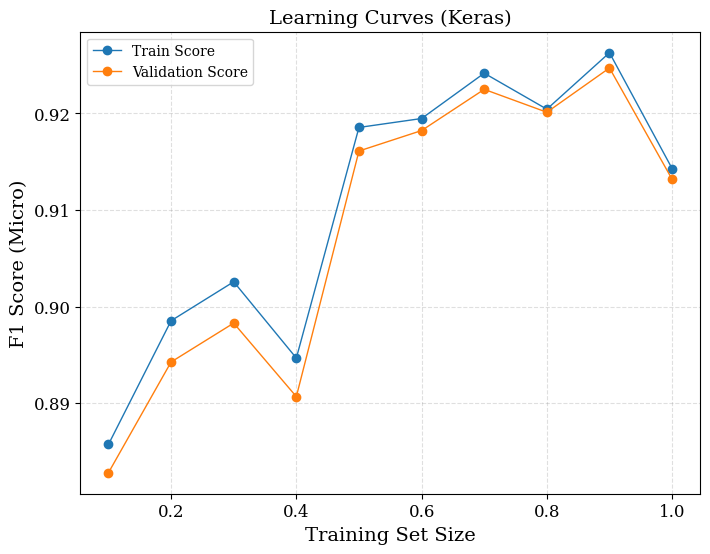

In [397]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score

# Размеры обучающего набора
train_sizes = np.linspace(0.1, 1.0, 10)

# Массивы для хранения результатов
train_scores = []
test_scores = []

for train_size in train_sizes:
    # Определяем количество данных для текущего размера
    subset_size = int(len(X_train_nn) * train_size)
    X_subset = X_train_nn[:subset_size]
    y_subset = y_train_nn[:subset_size]

    # Инициализируем модель
    model = build_model(X_train_nn.shape[1], y_train_nn.shape[1], trial=optuna.trial.FixedTrial(best_params_nn))
    model.fit(
        X_subset, y_subset,
        validation_data=(X_test_nn, y_test_nn),
        epochs=10,  # Уменьшите для ускорения
        batch_size=16,
        verbose=0
    )

    # Оценка на обучающем и тестовом наборах
    y_train_pred = (model.predict(X_subset) > 0.5).astype(int)
    y_test_pred = (model.predict(X_test_nn) > 0.5).astype(int)

    train_f1 = f1_score(y_subset, y_train_pred, average="micro")
    test_f1 = f1_score(y_test_nn, y_test_pred, average="micro")

    train_scores.append(train_f1)
    test_scores.append(test_f1)

# Построение графиков
plt.figure(figsize=(8, 6))
plt.plot(train_sizes, train_scores, label="Train Score", marker='o')
plt.plot(train_sizes, test_scores, label="Validation Score", marker='o')
plt.title("Learning Curves (Keras)")
plt.xlabel("Training Set Size")
plt.ylabel("F1 Score (Micro)")
plt.legend(loc="best")
plt.grid()
plt.show()

In [399]:
train_sizes, test_scores

(array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 [0.8827793822767576,
  0.8942505078726932,
  0.8982811787734963,
  0.8906636344620071,
  0.9161108109698368,
  0.9182308200353666,
  0.9224997868530992,
  0.9201264962570164,
  0.924715681563351,
  0.9131808348861616])

## Statistics

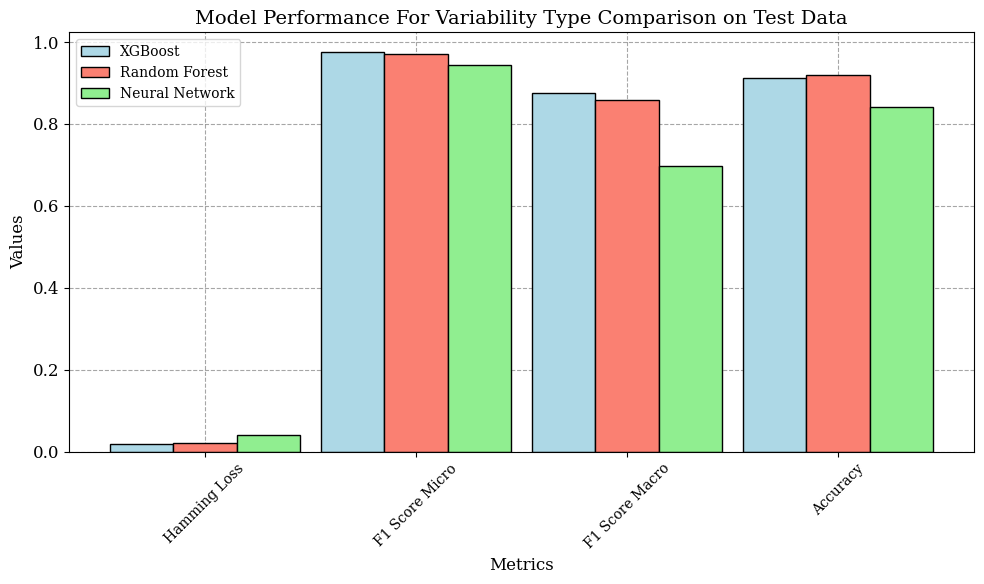

In [420]:
# Data for the models
metrics_to_plot = [
    "Hamming Loss (Test)", "F1 Score Micro (Test)", "F1 Score Macro (Test)", "Accuracy (Test)"
]
desired_metrics = ["Hamming Loss", "F1 Score Micro", "F1 Score Macro", "Accuracy"]

counts_xgboost = [0.0182, 0.9750, 0.8756, 0.9131]
counts_rf = [0.0220, 0.9697, 0.8579, 0.9199]
counts_nn = [0.0409, 0.9435, 0.6968, 0.8424]

# Indices for metrics
x = range(len(desired_metrics))

# Create the plot
fig, ax = plt.subplots(figsize=(10, 6))
bar_width = 0.3

# Add bars
ax.bar([i - bar_width for i in x], counts_xgboost, width=bar_width, label='XGBoost', color='lightblue', edgecolor='black')
ax.bar(x, counts_rf, width=bar_width, label='Random Forest', color='salmon', edgecolor='black')
ax.bar([i + bar_width for i in x], counts_nn, width=bar_width, label='Neural Network', color='lightgreen', edgecolor='black')

# Customize the plot
ax.set_title('Model Performance For Variability Type Comparison on Test Data', fontsize=14)
ax.set_xlabel('Metrics', fontsize=12)
ax.set_ylabel('Values', fontsize=12)
ax.set_xticks(x)
ax.set_xticklabels(desired_metrics, rotation=45, fontsize=10)
ax.legend(fontsize=10)
ax.grid(linestyle='--', alpha=0.7)

# Display the plot
plt.tight_layout()
plt.savefig('output/var_type_ml_comparison.png', dpi=300)
plt.show()

In [414]:
# Generate LaTeX table
latex_table = df.to_latex(index=False, caption="Model Evaluation Metrics", label="tab:model_metrics")
print(latex_table)

\begin{table}
\caption{Model Evaluation Metrics}
\label{tab:model_metrics}
\begin{tabular}{lrrr}
\toprule
Metric & XGBoost & Random Forest & Neural Network \\
\midrule
Hamming Loss (Train) & 0.007000 & 0.017700 & 0.040600 \\
Hamming Loss (Test) & 0.018200 & 0.022000 & 0.040900 \\
F1 Score Micro (Train) & 0.990300 & 0.975700 & 0.944000 \\
F1 Score Micro (Test) & 0.975000 & 0.969700 & 0.943500 \\
F1 Score Macro (Train) & 0.949600 & 0.885600 & 0.695700 \\
F1 Score Macro (Test) & 0.875600 & 0.857900 & 0.696800 \\
ROC-AUC Micro (Train) & 0.999700 & NaN & NaN \\
ROC-AUC Micro (Test) & 0.998000 & NaN & NaN \\
Accuracy (Train) & 0.961900 & 0.935300 & 0.844600 \\
Accuracy (Test) & 0.913100 & 0.919900 & 0.842400 \\
\bottomrule
\end{tabular}
\end{table}



# Spectral type

## Data

In [428]:
df_crop_spec.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13578 entries, 0 to 13577
Data columns (total 16 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   RA                          13578 non-null  float64
 1   DEC                         13578 non-null  float64
 2   LII                         13578 non-null  float64
 3   BII                         13578 non-null  float64
 4   parallax                    12550 non-null  float64
 5   pmra                        12545 non-null  float64
 6   pmdec                       12545 non-null  float64
 7   pm                          12545 non-null  float64
 8   phot_g_mean_mag             13229 non-null  float64
 9   bp_rp                       12481 non-null  float64
 10  bp_g                        12481 non-null  float64
 11  g_rp                        12486 non-null  float64
 12  is_bound_period_final       13578 non-null  int64  
 13  is_mean_cycle_period_final  135

In [430]:
df_crop_spec.spectral_group_final.unique()

array(['M', 'F', 'A', 'S (Zirconium)', 'K', 'G', 'Peculiar', 'B',
       'C (Carbon)', 'WD (White Dwarf)', 'O'], dtype=object)

In [432]:
df_crop_spec.isna().sum()

RA                               0
DEC                              0
LII                              0
BII                              0
parallax                      1028
pmra                          1033
pmdec                         1033
pm                            1033
phot_g_mean_mag                349
bp_rp                         1097
bp_g                          1097
g_rp                          1092
is_bound_period_final            0
is_mean_cycle_period_final       0
period_final                  4402
spectral_group_final             0
dtype: int64

In [434]:
def fill_na_with_group_median(df, group_col, target_cols):
    """
    Заполняет пропуски медианными значениями внутри каждой группы.

    :param df: DataFrame с данными
    :param group_col: Название столбца для группировки
    :param target_cols: Список столбцов, в которых нужно заполнить пропуски
    :return: DataFrame с заполненными пропусками
    """
    for col in target_cols:
        df[col] = df.groupby(group_col)[col].transform(
            lambda x: x.fillna(x.median())
        )
    return df


# Столбцы с пропусками, которые нужно заполнить
target_columns = ['parallax', 'pmra', 'pmdec', 'pm', 'phot_g_mean_mag', 'bp_rp', 'bp_g', 'g_rp', 'period_final']

# Заполнение пропусков медианами групп спектрального типа
df_crop_spec = fill_na_with_group_median(df_crop_spec, 'spectral_group_final', target_columns)

# Проверка оставшихся пропусков
missing_summary = df_crop_spec[target_columns].isna().sum()
print("Оставшиеся пропуски по столбцам:\n", missing_summary)

Оставшиеся пропуски по столбцам:
 parallax           0
pmra               0
pmdec              0
pm                 0
phot_g_mean_mag    0
bp_rp              0
bp_g               0
g_rp               0
period_final       0
dtype: int64


In [438]:
from sklearn.preprocessing import OneHotEncoder
import numpy as np
import pandas as pd

# OneHotEncoding для спектрального типа
encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')
y_spec = encoder.fit_transform(df_crop_spec[['spectral_group_final']])

# Отбираем только числовые признаки
X_spec = df_crop_spec[['LII', 'BII', 'parallax', 'pmra', 'pmdec', 'pm',
                       'phot_g_mean_mag', 'bp_rp', 'bp_g', 'g_rp', 
                       'is_bound_period_final', 'is_mean_cycle_period_final', 'period_final']]

# Добавляем расчет галактического расстояния
R_sun = 8.2  # Расстояние от Солнца до галактического центра в кпк
X_spec['R_gal'] = np.sqrt(
    R_sun**2 + (1 / X_spec['parallax'])**2 -
    2 * R_sun * (1 / X_spec['parallax']) * 
    np.cos(np.radians(X_spec['LII'])) * np.cos(np.radians(X_spec['BII']))
)

# Заполняем пропуски в `R_gal` (в случае некорректных/неконвертируемых значений)
X_spec['R_gal'] = X_spec['R_gal'].replace([np.inf, -np.inf], np.nan).fillna(X_spec['R_gal'].median())

# Проверим результат
print(f"Размер матрицы признаков: {X_spec.shape}")
print(f"Размер матрицы меток (OneHot): {y_spec.shape}")

# Убедимся, что все пропуски в числовых столбцах заполнены
assert X_spec.isna().sum().sum() == 0, "В данных остались пропуски!"

Размер матрицы признаков: (13578, 14)
Размер матрицы меток (OneHot): (13578, 11)


/opt/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1214116547.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_spec['R_gal'] = np.sqrt(
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1214116547.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

## XGBoost

In [453]:
# OneHotEncoding для спектрального типа
encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')
y_spec = encoder.fit_transform(df_crop_spec[['spectral_group_final']])
y_labels = encoder.categories_[0]  # Сохраняем названия категорий

# Отбираем только числовые признаки
X_spec = df_crop_spec[['LII', 'BII', 'parallax', 'pmra', 'pmdec', 'pm',
                       'phot_g_mean_mag', 'bp_rp', 'bp_g', 'g_rp',
                       'is_bound_period_final', 'is_mean_cycle_period_final', 'period_final']]

# Добавляем галактическое расстояние
R_sun = 8.2  # Расстояние от Солнца до галактического центра в кпк
X_spec['R_gal'] = np.sqrt(
    R_sun**2 + (1 / X_spec['parallax'])**2 -
    2 * R_sun * (1 / X_spec['parallax']) *
    np.cos(np.radians(X_spec['LII'])) * np.cos(np.radians(X_spec['BII']))
)
X_spec['R_gal'] = X_spec['R_gal'].replace([np.inf, -np.inf], np.nan).fillna(X_spec['R_gal'].median())

/opt/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/2265873744.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_spec['R_gal'] = np.sqrt(
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/2265873744.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

In [457]:
X_spec

,LII,BII,parallax,pmra,pmdec,pm,phot_g_mean_mag,bp_rp,bp_g,g_rp,is_bound_period_final,is_mean_cycle_period_final,period_final,R_gal
0,303.04421,-26.92306,1.823725,-8.021890,-8.667740,11.810184,5.533397,2.788678,1.557711,1.230967,0,0,2.382017,7.947868
1,303.90523,-27.71347,11.100476,26.322593,4.720700,26.742548,5.374763,0.418131,0.148731,0.269401,0,0,-1.013228,8.155889
2,304.24164,-25.67579,15.476353,-88.390544,-80.292838,119.414520,6.435517,0.389273,0.134555,0.254718,0,0,-1.096910,8.167422
3,301.51360,-29.28628,0.639691,3.833574,1.551566,4.135655,14.046634,0.449441,0.113867,0.335574,0,0,2.485349,7.615502
4,304.50285,-29.73145,0.206334,1.885453,-5.459257,5.775674,11.199433,4.235735,2.694339,1.541396,0,0,2.255658,7.185590
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13573,120.20165,24.82807,0.603080,-1.566096,-0.519717,1.650079,8.521826,4.704110,3.133929,1.570180,0,0,2.528145,9.077707
13574,121.14616,26.46714,0.486553,-4.928644,-2.287577,5.433649,11.390509,6.000096,4.347745,1.652351,0,0,2.528917,9.331168
13575,122.90025,28.17032,2.001303,7.541588,-7.157466,10.397349,9.680956,0.539478,0.198807,0.340672,0,0,0.854428,8.450656
13576,121.81296,27.29967,13.309589,56.029405,126.200566,138.079239,8.358688,0.808739,0.314384,0.494354,0,0,0.606749,8.235463


In [455]:
# Разделение данных
X_train_xgb, X_test_xgb, y_train_xgb, y_test_xgb = train_test_split(
    X_spec, y_spec, test_size=0.2, random_state=42
)

In [459]:
# Вычисляем веса классов
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.arange(y_spec.shape[1]),
    y=np.argmax(y_train_xgb, axis=1)
)
sample_weights_xgb = np.array([class_weights[label] for label in np.argmax(y_train_xgb, axis=1)])

In [503]:
# Целевая функция для Optuna с кросс-валидацией
def objective_xgb(trial):
    param_xgb = {
        "objective": "multi:softprob",  # Многоклассовая классификация
        "num_class": y_spec.shape[1],  # Количество классов
        "n_estimators": trial.suggest_int("n_estimators", 50, 200),
        "max_depth": trial.suggest_int("max_depth", 5, 10),
        "subsample": trial.suggest_float("subsample", 0.8, 0.9),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.85, 0.9),
        "lambda": trial.suggest_loguniform("lambda", 3, 7.0),
        "alpha": trial.suggest_loguniform("alpha", 1, 10.0),
        "learning_rate": trial.suggest_float("learning_rate", 0.05, 0.1),
        "random_state": 42
    }
    model_xgb = XGBClassifier(**param_xgb)
    
    # Кросс-валидация
    scores = cross_val_score(
        model_xgb, 
        X_train_xgb, 
        np.argmax(y_train_xgb, axis=1), 
        scoring="f1_weighted", 
        cv=5,  # Число фолдов
        n_jobs=-1  # Параллельное выполнение
    )
    
    # Возвращаем среднее значение F1-метрики по фолдам
    return np.mean(scores)

# Отслеживание времени начала
start_time_xgb = time.time()

# Запуск Optuna
study_xgb = optuna.create_study(direction="maximize")
study_xgb.optimize(objective_xgb, n_trials=50)

# Отслеживание времени завершения
end_time_xgb = time.time()

[I 2025-01-13 12:31:02,128] A new study created in memory with name: no-name-cacfe20e-5dae-4b2e-bd09-f5809288d679
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/482572138.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda": trial.suggest_loguniform("lambda", 3, 7.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/482572138.py:11: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "alpha": trial.suggest_loguniform("alpha", 1, 10.0),
[I 2025-01-13 12:31:04,729] Trial 0 finished with value: 0.8426034006921299 and parameters: {'n_estimators': 133, 'max_depth': 9, 'subsample': 0.7346441205536864, 'colsample_bytree': 0.8423657639519381, 

In [504]:
# Лучшие параметры
best_params_xgb = study_xgb.best_params
print("\nЛучшие параметры:", best_params_xgb)

# Время выполнения
execution_time_xgb = end_time_xgb - start_time_xgb
print(f"\nВремя выполнения: {execution_time_xgb:.2f} секунд ({execution_time_xgb / 60:.2f} минут)")


# Обучение с лучшими параметрами
best_model_xgb = XGBClassifier(**best_params_xgb, random_state=42)
best_model_xgb.fit(X_train_xgb, np.argmax(y_train_xgb, axis=1), sample_weight=sample_weights_xgb)

# Оценка модели
y_train_pred_xgb = best_model_xgb.predict(X_train_xgb)
y_test_pred_xgb = best_model_xgb.predict(X_test_xgb)

accuracy_train_xgb = accuracy_score(np.argmax(y_train_xgb, axis=1), y_train_pred_xgb)
accuracy_test_xgb = accuracy_score(np.argmax(y_test_xgb, axis=1), y_test_pred_xgb)

f1_weighted_train_xgb = f1_score(np.argmax(y_train_xgb, axis=1), y_train_pred_xgb, average='weighted')
f1_weighted_test_xgb = f1_score(np.argmax(y_test_xgb, axis=1), y_test_pred_xgb, average='weighted')

print("\nОценка модели:")
print(f"Accuracy (Train): {accuracy_train_xgb:.4f}")
print(f"Accuracy (Test): {accuracy_test_xgb:.4f}")
print(f"F1 Score Weighted (Train): {f1_weighted_train_xgb:.4f}")
print(f"F1 Score Weighted (Test): {f1_weighted_test_xgb:.4f}")


Лучшие параметры: {'n_estimators': 180, 'max_depth': 9, 'subsample': 0.8303493837181493, 'colsample_bytree': 0.8177775603549038, 'lambda': 5.16927549426152, 'alpha': 1.1568256754834207, 'learning_rate': 0.06648970433903387}

Время выполнения: 139.75 секунд (2.33 минут)

Оценка модели:
Accuracy (Train): 0.9773
Accuracy (Test): 0.8402
F1 Score Weighted (Train): 0.9775
F1 Score Weighted (Test): 0.8411



Важность признаков:
                       Feature  Importance
11  is_mean_cycle_period_final    0.343881
12                period_final    0.184998
7                        bp_rp    0.144541
9                         g_rp    0.057589
8                         bp_g    0.055565
2                     parallax    0.051363
6              phot_g_mean_mag    0.048964
5                           pm    0.030519
13                       R_gal    0.019006
1                          BII    0.018398
4                        pmdec    0.015433
3                         pmra    0.015271
0                          LII    0.014472
10       is_bound_period_final    0.000000


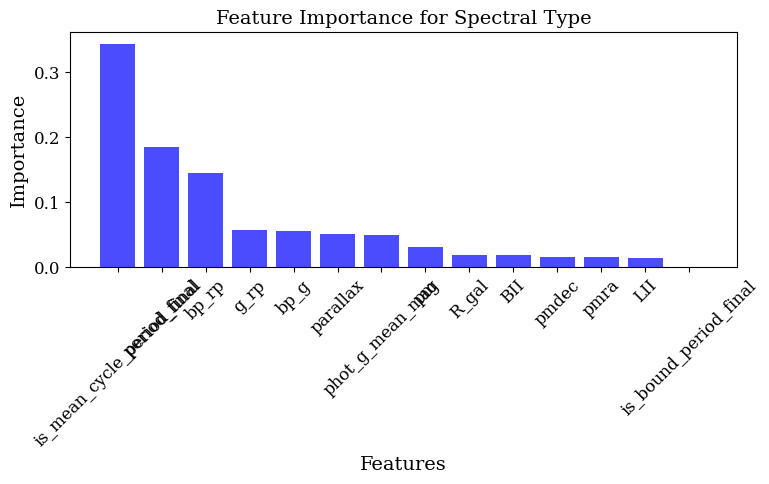

In [507]:
# Важность признаков
feature_importance_spec_xgb = pd.DataFrame({
    'Feature': X_spec.columns,
    'Importance': best_model_xgb.feature_importances_
}).sort_values(by='Importance', ascending=False)

print("\nВажность признаков:")
print(feature_importance_spec_xgb)

# График важности признаков
plt.figure(figsize=(8, 5))
plt.bar(feature_importance_spec_xgb['Feature'], feature_importance_spec_xgb['Importance'], color='blue', alpha=0.7)
plt.title('Feature Importance for Spectral Type')
plt.ylabel('Importance')
plt.xlabel('Features')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [509]:
# Сохранение модели
dump(best_model_xgb, 'xgboost_spectral_model.joblib')

['xgboost_spectral_model.joblib']

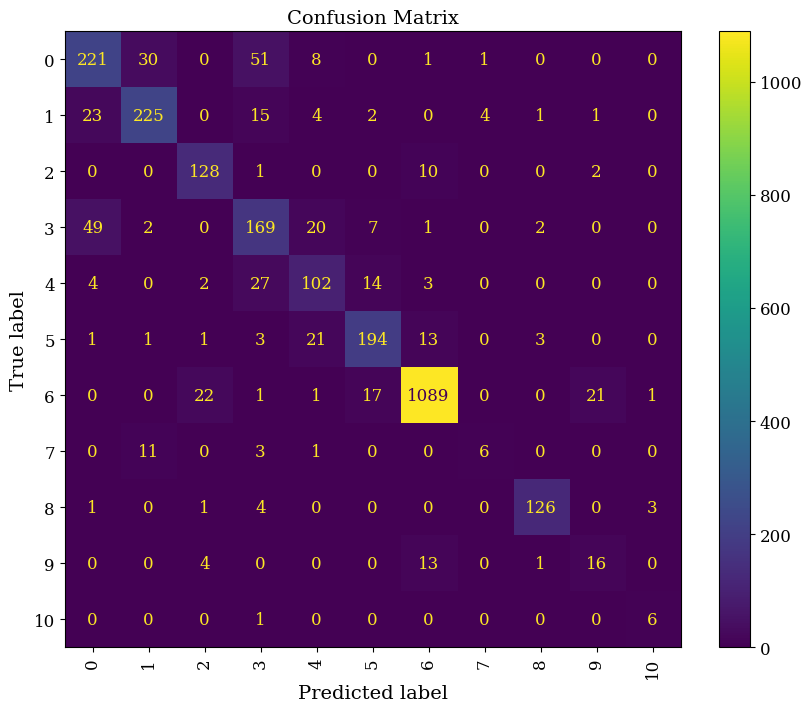

In [523]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Предположим, что y_test_pred_xgb содержит предсказания модели
# y_test_xgb — истинные метки классов

# Построение матрицы ошибок
conf_matrix = confusion_matrix(np.argmax(y_test_xgb, axis=1), y_test_pred_xgb)

# Визуализация матрицы ошибок
fig, ax = plt.subplots(figsize=(10, 8))
disp = ConfusionMatrixDisplay(conf_matrix, display_labels=np.arange(11))  # Учитываем 11 классов
disp.plot(cmap='viridis', ax=ax, xticks_rotation='vertical')
plt.title("Confusion Matrix")
plt.show()

In [525]:
print(y_test_xgb[:5])  # Проверить первые 5 истинных значений
print(y_test_pred_xgb[:5])  # Проверить первые 5 предсказаний

[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
[1 4 3 5 1]


In [531]:
import lightgbm as lgb
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
import optuna
import numpy as np
import matplotlib.pyplot as plt

# Разделение данных
X_train_lgb, X_test_lgb, y_train_lgb, y_test_lgb = train_test_split(
    X_spec, y_spec, test_size=0.2, random_state=42
)

# Целевая функция для Optuna
def objective_lgb(trial):
    param_lgb = {
        "objective": "multiclass",
        "num_class": y_spec.shape[1],
        "metric": "multi_logloss",
        "boosting_type": "gbdt",
        "num_leaves": trial.suggest_int("num_leaves", 31, 128),
        "max_depth": trial.suggest_int("max_depth", -1, 10),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.2),
        "n_estimators": trial.suggest_int("n_estimators", 50, 200),
        "min_child_samples": trial.suggest_int("min_child_samples", 20, 100),
        "subsample": trial.suggest_float("subsample", 0.6, 0.9),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, 0.9),
        "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
        "lambda_l2": trial.suggest_loguniform("lambda_l2", 1e-3, 10.0),
    }

    # Модель LightGBM
    model_lgb = lgb.LGBMClassifier(**param_lgb)
    
    # Кросс-валидация
    scores = cross_val_score(
        model_lgb,
        X_train_lgb,
        np.argmax(y_train_lgb, axis=1),
        scoring="f1_weighted",
        cv=5,
        n_jobs=-1
    )
    
    return np.mean(scores)

In [533]:
# Засекаем время начала
start_time_lgb = time.time()

# Запуск Optuna
study_lgb = optuna.create_study(direction="maximize")
study_lgb.optimize(objective_lgb, n_trials=50)

# Засекаем время окончания
end_time_lgb = time.time()

# Вывод времени выполнения
execution_time_lgb = end_time_lgb - start_time_lgb

[I 2025-01-13 12:44:28,181] A new study created in memory with name: no-name-d2d9db40-1205-42a2-9bba-a6d53ed96615
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l2": trial.suggest_loguniform("lambda_l2", 1e-3, 10.0),


[LightGBM] [Warning] lambda_l1 is set=0.47536462661875634, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47536462661875634
[LightGBM] [Warning] lambda_l2 is set=0.005836961306473099, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005836961306473099
[LightGBM] [Warning] lambda_l1 is set=0.47536462661875634, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47536462661875634
[LightGBM] [Warning] lambda_l2 is set=0.005836961306473099, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005836961306473099
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009149 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3060
[LightGBM] [Info] Number of data points in the train set: 8689, number of used features: 12
[LightGBM] [Info] Start training from score -2.146185
[LightGBM] [Info] Start training from score -2.343580
[LightGBM] [Info] Start training from score -2.983038
[Lig

[I 2025-01-13 12:44:38,557] Trial 0 finished with value: 0.8505051388230491 and parameters: {'num_leaves': 94, 'max_depth': 4, 'learning_rate': 0.12463085828931471, 'n_estimators': 108, 'min_child_samples': 79, 'subsample': 0.6916426718927857, 'colsample_bytree': 0.8041345458549899, 'lambda_l1': 0.47536462661875634, 'lambda_l2': 0.005836961306473099}. Best is trial 0 with value: 0.8505051388230491.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:44:57,094] Trial 1 finished with value: 0.852809931995697 and parameters: {'num_leaves': 84, 'max_depth': 5, 'learning_rate': 0.09461652814005365, 'n_estimators': 149, 'min_child_samples': 60, 'subsample': 0.6251916942649026, 'colsample_bytree': 0.7124401801942291, 'lambda_l1': 0.001245935560010458, 'lambda_l2': 3.2632726951026334}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:45:16,973] Trial 2 finished with value: 0.8485803993746904 and parameters: {'num_leaves': 35, 'max_depth': 9, 'learning_rate': 0.140279920852427, 'n_estimators': 87, 'min_child_samples': 38, 'subsample': 0.657154476804565, 'colsample_bytree': 0.7772248416058519, 'lambda_l1': 0.03959293386602204, 'lambda_l2': 0.022098596137309513}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use s

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:45:30,935] Trial 3 finished with value: 0.8479125269766579 and parameters: {'num_leaves': 109, 'max_depth': 6, 'learning_rate': 0.13854633321412532, 'n_estimators': 86, 'min_child_samples': 57, 'subsample': 0.6208501591951533, 'colsample_bytree': 0.689389465958776, 'lambda_l1': 0.0010051090030798989, 'lambda_l2': 0.21829718771345966}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:45:54,032] Trial 4 finished with value: 0.8468444027333362 and parameters: {'num_leaves': 35, 'max_depth': 6, 'learning_rate': 0.13945766663409276, 'n_estimators': 166, 'min_child_samples': 79, 'subsample': 0.6053278744027388, 'colsample_bytree': 0.8813075770905575, 'lambda_l1': 0.011587174416594742, 'lambda_l2': 0.001010231687323394}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:46:27,408] Trial 5 finished with value: 0.850504819126989 and parameters: {'num_leaves': 87, 'max_depth': 8, 'learning_rate': 0.18639307531876284, 'n_estimators': 167, 'min_child_samples': 32, 'subsample': 0.6741663300605212, 'colsample_bytree': 0.864760635942484, 'lambda_l1': 0.06356635713499266, 'lambda_l2': 0.04057804139690742}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:47:13,068] Trial 6 finished with value: 0.8519625324201335 and parameters: {'num_leaves': 96, 'max_depth': 9, 'learning_rate': 0.13759885056120857, 'n_estimators': 141, 'min_child_samples': 28, 'subsample': 0.7650747518158295, 'colsample_bytree': 0.6285901636534031, 'lambda_l1': 0.38205899827864004, 'lambda_l2': 3.837980259608202}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:47:15,804] Trial 7 finished with value: 0.8066380116542706 and parameters: {'num_leaves': 96, 'max_depth': 1, 'learning_rate': 0.18815722701324916, 'n_estimators': 134, 'min_child_samples': 97, 'subsample': 0.6698454437275597, 'colsample_bytree': 0.6781082270637715, 'lambda_l1': 4.146622740479691, 'lambda_l2': 0.003096547379361043}. Best is trial 1 with value: 0.852809931995697.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l2": trial.suggest_loguniform("lambda_l2", 1e-3, 10.0),


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:47:21,012] Trial 8 finished with value: 0.8454424323408724 and parameters: {'num_leaves': 121, 'max_depth': 2, 'learning_rate': 0.16168625615785073, 'n_estimators': 155, 'min_child_samples': 61, 'subsample': 0.7874924955993715, 'colsample_bytree': 0.7653047421945008, 'lambda_l1': 0.010953348401962366, 'lambda_l2': 2.3064213718213504}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:47:25,116] Trial 9 finished with value: 0.8435899783401639 and parameters: {'num_leaves': 49, 'max_depth': 3, 'learning_rate': 0.15454598885576806, 'n_estimators': 69, 'min_child_samples': 87, 'subsample': 0.8195696986924719, 'colsample_bytree': 0.8025290438773566, 'lambda_l1': 0.5396895134052604, 'lambda_l2': 0.17581978246137567}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:48:30,283] Trial 10 finished with value: 0.8519621456649936 and parameters: {'num_leaves': 66, 'max_depth': -1, 'learning_rate': 0.07372477081403722, 'n_estimators': 197, 'min_child_samples': 55, 'subsample': 0.716532993513981, 'colsample_bytree': 0.7067165367599415, 'lambda_l1': 0.0012855500315673994, 'lambda_l2': 0.8553553555605838}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:55:40,659] Trial 11 finished with value: 0.811578927141998 and parameters: {'num_leaves': 70, 'max_depth': 10, 'learning_rate': 0.01068523601524525, 'n_estimators': 131, 'min_child_samples': 22, 'subsample': 0.8897473957939876, 'colsample_bytree': 0.6262424809588454, 'lambda_l1': 0.5403718814867559, 'lambda_l2': 9.771515011270433}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:56:06,099] Trial 12 finished with value: 0.8499403605923771 and parameters: {'num_leaves': 75, 'max_depth': 7, 'learning_rate': 0.08302964647099678, 'n_estimators': 147, 'min_child_samples': 40, 'subsample': 0.7578617074627209, 'colsample_bytree': 0.6121064291110785, 'lambda_l1': 3.442412077537871, 'lambda_l2': 9.17231459313904}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use su

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:56:32,501] Trial 13 finished with value: 0.852084279954451 and parameters: {'num_leaves': 113, 'max_depth': 5, 'learning_rate': 0.09330075035758068, 'n_estimators': 191, 'min_child_samples': 20, 'subsample': 0.8404738423884579, 'colsample_bytree': 0.6508772423615229, 'lambda_l1': 0.2534622841613877, 'lambda_l2': 1.4094635645224742}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:56:56,972] Trial 14 finished with value: 0.8503294496372445 and parameters: {'num_leaves': 124, 'max_depth': 5, 'learning_rate': 0.05217745397524595, 'n_estimators': 199, 'min_child_samples': 47, 'subsample': 0.8612047769513315, 'colsample_bytree': 0.7179504718931436, 'lambda_l1': 0.005695232673146946, 'lambda_l2': 0.7929540133000509}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:57:12,207] Trial 15 finished with value: 0.8502892158656785 and parameters: {'num_leaves': 108, 'max_depth': 4, 'learning_rate': 0.10430748019361409, 'n_estimators': 175, 'min_child_samples': 72, 'subsample': 0.8238703102317586, 'colsample_bytree': 0.6564095761620115, 'lambda_l1': 0.15204896002038204, 'lambda_l2': 1.0980989603817775}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:57:16,214] Trial 16 finished with value: 0.7665263554347452 and parameters: {'num_leaves': 58, 'max_depth': 1, 'learning_rate': 0.04390827001405546, 'n_estimators': 184, 'min_child_samples': 21, 'subsample': 0.7279892514038717, 'colsample_bytree': 0.7337384321124464, 'lambda_l1': 2.20230326810061, 'lambda_l2': 0.34602381101894425}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:57:34,046] Trial 17 finished with value: 0.8500137443091249 and parameters: {'num_leaves': 111, 'max_depth': 6, 'learning_rate': 0.09681221776619732, 'n_estimators': 113, 'min_child_samples': 69, 'subsample': 0.8991224936101647, 'colsample_bytree': 0.6612129072237983, 'lambda_l1': 0.003253325665382337, 'lambda_l2': 2.72697406684224}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:57:36,927] Trial 18 finished with value: 0.820042833170368 and parameters: {'num_leaves': 86, 'max_depth': 3, 'learning_rate': 0.06299843050850351, 'n_estimators': 50, 'min_child_samples': 99, 'subsample': 0.8214930243111604, 'colsample_bytree': 0.7411234399450234, 'lambda_l1': 0.029461025431870708, 'lambda_l2': 0.07622231009252556}. Best is trial 1 with value: 0.852809931995697.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l2": trial.suggest_loguniform("lambda_l2", 1e-3, 10.0),


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:58:00,472] Trial 19 finished with value: 0.8493287095935692 and parameters: {'num_leaves': 117, 'max_depth': 5, 'learning_rate': 0.11694371201310892, 'n_estimators': 185, 'min_child_samples': 48, 'subsample': 0.6385216433655151, 'colsample_bytree': 0.6004426146929188, 'lambda_l1': 0.15490718092132444, 'lambda_l2': 0.4993422294208919}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:58:21,323] Trial 20 finished with value: 0.8428918152464362 and parameters: {'num_leaves': 101, 'max_depth': 7, 'learning_rate': 0.024374013402399045, 'n_estimators': 118, 'min_child_samples': 66, 'subsample': 0.8601635815551159, 'colsample_bytree': 0.6589134985320396, 'lambda_l1': 0.027635456241540186, 'lambda_l2': 2.028300814903816}. Best is trial 1 with value: 0.852809931995697.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:59:03,504] Trial 21 finished with value: 0.8531422814862262 and parameters: {'num_leaves': 83, 'max_depth': 9, 'learning_rate': 0.09285835683793878, 'n_estimators': 146, 'min_child_samples': 28, 'subsample': 0.7598382880260699, 'colsample_bytree': 0.640528598669551, 'lambda_l1': 1.1368088467872195, 'lambda_l2': 4.341663473294781}. Best is trial 21 with value: 0.8531422814862262.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l2": trial.suggest_loguniform("lambda_l2", 1e-3, 10.0),


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:59:19,071] Trial 22 finished with value: 0.8429096949732842 and parameters: {'num_leaves': 79, 'max_depth': 10, 'learning_rate': 0.09000950052028976, 'n_estimators': 155, 'min_child_samples': 31, 'subsample': 0.7890926108088266, 'colsample_bytree': 0.644285875294634, 'lambda_l1': 9.177984915351388, 'lambda_l2': 4.797148411017748}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 12:59:57,721] Trial 23 finished with value: 0.8511264853340037 and parameters: {'num_leaves': 59, 'max_depth': 8, 'learning_rate': 0.11195970849741091, 'n_estimators': 161, 'min_child_samples': 40, 'subsample': 0.7300359806052031, 'colsample_bytree': 0.6933915747932163, 'lambda_l1': 1.1392379353193338, 'lambda_l2': 5.53828409329686}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:00:33,011] Trial 24 finished with value: 0.8498122969886743 and parameters: {'num_leaves': 128, 'max_depth': -1, 'learning_rate': 0.07393122656666812, 'n_estimators': 100, 'min_child_samples': 26, 'subsample': 0.6964055462153218, 'colsample_bytree': 0.6754158495112849, 'lambda_l1': 1.1794606993772643, 'lambda_l2': 2.0274558839059487}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:01:14,704] Trial 25 finished with value: 0.8506230369083643 and parameters: {'num_leaves': 87, 'max_depth': 7, 'learning_rate': 0.08820397841012731, 'n_estimators': 179, 'min_child_samples': 35, 'subsample': 0.7779704911825833, 'colsample_bytree': 0.6353469772652737, 'lambda_l1': 0.2037800710701174, 'lambda_l2': 1.1051276080931378}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:01:22,022] Trial 26 finished with value: 0.8331811413742474 and parameters: {'num_leaves': 48, 'max_depth': 3, 'learning_rate': 0.04075052013566451, 'n_estimators': 125, 'min_child_samples': 49, 'subsample': 0.8427668103409156, 'colsample_bytree': 0.7159469472502943, 'lambda_l1': 1.3342081411910154, 'lambda_l2': 0.39005591842284626}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:01:44,033] Trial 27 finished with value: 0.8474712487193488 and parameters: {'num_leaves': 82, 'max_depth': 5, 'learning_rate': 0.10344635718047439, 'n_estimators': 144, 'min_child_samples': 22, 'subsample': 0.7517882111792922, 'colsample_bytree': 0.6772609368477188, 'lambda_l1': 0.07633082848906045, 'lambda_l2': 4.967620022926219}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:02:36,408] Trial 28 finished with value: 0.8508272987583734 and parameters: {'num_leaves': 103, 'max_depth': 9, 'learning_rate': 0.06444619529510091, 'n_estimators': 193, 'min_child_samples': 44, 'subsample': 0.8027020241506317, 'colsample_bytree': 0.6162806390505188, 'lambda_l1': 0.25114281309863, 'lambda_l2': 0.10286953319446387}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:02:45,133] Trial 29 finished with value: 0.8475585234506277 and parameters: {'num_leaves': 74, 'max_depth': 4, 'learning_rate': 0.12422934556502528, 'n_estimators': 101, 'min_child_samples': 89, 'subsample': 0.6954111741667404, 'colsample_bytree': 0.8197677429575518, 'lambda_l1': 0.7648835742028037, 'lambda_l2': 0.020056882224990163}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:02:51,220] Trial 30 finished with value: 0.8384179457794261 and parameters: {'num_leaves': 91, 'max_depth': 2, 'learning_rate': 0.07561911917177891, 'n_estimators': 173, 'min_child_samples': 75, 'subsample': 0.8782710386584237, 'colsample_bytree': 0.7026113320864242, 'lambda_l1': 0.34769146958245484, 'lambda_l2': 1.47609020839853}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:03:35,539] Trial 31 finished with value: 0.8529740465251751 and parameters: {'num_leaves': 97, 'max_depth': 9, 'learning_rate': 0.11827801970962566, 'n_estimators': 138, 'min_child_samples': 30, 'subsample': 0.7601022071771132, 'colsample_bytree': 0.636286208742831, 'lambda_l1': 0.3424318239182216, 'lambda_l2': 3.5860491240097923}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:04:23,848] Trial 32 finished with value: 0.8524797727385354 and parameters: {'num_leaves': 100, 'max_depth': 8, 'learning_rate': 0.11674092345930767, 'n_estimators': 150, 'min_child_samples': 26, 'subsample': 0.7347821655313548, 'colsample_bytree': 0.6494786199796114, 'lambda_l1': 0.08213665174311346, 'lambda_l2': 3.2601098366621994}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:05:13,826] Trial 33 finished with value: 0.8509488013516073 and parameters: {'num_leaves': 103, 'max_depth': 8, 'learning_rate': 0.11279744456597522, 'n_estimators': 151, 'min_child_samples': 27, 'subsample': 0.7368144624408384, 'colsample_bytree': 0.6359165524111017, 'lambda_l1': 0.015006432339068917, 'lambda_l2': 7.427062237533695}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:06:00,731] Trial 34 finished with value: 0.8508787819132004 and parameters: {'num_leaves': 94, 'max_depth': 10, 'learning_rate': 0.1275027983299926, 'n_estimators': 135, 'min_child_samples': 39, 'subsample': 0.7105456828789708, 'colsample_bytree': 0.6001813147983619, 'lambda_l1': 0.0019380423737784828, 'lambda_l2': 3.405904725092193}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:06:45,185] Trial 35 finished with value: 0.8509185257050997 and parameters: {'num_leaves': 81, 'max_depth': 9, 'learning_rate': 0.12768248454900255, 'n_estimators': 126, 'min_child_samples': 32, 'subsample': 0.6424830028931409, 'colsample_bytree': 0.6753824855585451, 'lambda_l1': 0.005985880415895857, 'lambda_l2': 0.6057941041564898}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:07:26,799] Trial 36 finished with value: 0.8511662089066936 and parameters: {'num_leaves': 99, 'max_depth': 8, 'learning_rate': 0.1580517182473548, 'n_estimators': 164, 'min_child_samples': 54, 'subsample': 0.6116734295066762, 'colsample_bytree': 0.7768358598354299, 'lambda_l1': 0.05128282028330856, 'lambda_l2': 3.2949420642308724}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:08:04,972] Trial 37 finished with value: 0.8487821481953496 and parameters: {'num_leaves': 91, 'max_depth': 9, 'learning_rate': 0.14802897626530903, 'n_estimators': 140, 'min_child_samples': 35, 'subsample': 0.7722526387540759, 'colsample_bytree': 0.6222426643009927, 'lambda_l1': 0.11501267258530173, 'lambda_l2': 0.01070872459964489}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0.

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:08:12,448] Trial 38 finished with value: 0.845495602207388 and parameters: {'num_leaves': 107, 'max_depth': 7, 'learning_rate': 0.17001757650070384, 'n_estimators': 118, 'min_child_samples': 63, 'subsample': 0.6767091399372884, 'colsample_bytree': 0.7305704041513646, 'lambda_l1': 8.196461385890414, 'lambda_l2': 0.2759624418968696}. Best is trial 21 with value: 0.8531422814862262.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l2": trial.suggest_loguniform("lambda_l2", 1e-3, 10.0),


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:08:32,682] Trial 39 finished with value: 0.8498210063976058 and parameters: {'num_leaves': 86, 'max_depth': 8, 'learning_rate': 0.1342453719504147, 'n_estimators': 158, 'min_child_samples': 26, 'subsample': 0.7429250046518396, 'colsample_bytree': 0.7572029562313712, 'lambda_l1': 2.3123992428064457, 'lambda_l2': 0.001010966189119699}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:09:03,352] Trial 40 finished with value: 0.8489843509325661 and parameters: {'num_leaves': 64, 'max_depth': 9, 'learning_rate': 0.17376923373453318, 'n_estimators': 148, 'min_child_samples': 82, 'subsample': 0.7981725104510995, 'colsample_bytree': 0.6933316686459947, 'lambda_l1': 0.7833530863957894, 'lambda_l2': 5.384267412648245}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:09:31,904] Trial 41 finished with value: 0.8524125266552872 and parameters: {'num_leaves': 114, 'max_depth': 6, 'learning_rate': 0.0958360377604469, 'n_estimators': 140, 'min_child_samples': 20, 'subsample': 0.6577411025369876, 'colsample_bytree': 0.6478885723541196, 'lambda_l1': 0.2843682980582783, 'lambda_l2': 1.6776540187499396}. Best is trial 21 with value: 0.8531422814862262.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l2": trial.suggest_loguniform("lambda_l2", 1e-3, 10.0),


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:09:57,365] Trial 42 finished with value: 0.8507183826140595 and parameters: {'num_leaves': 115, 'max_depth': 6, 'learning_rate': 0.100468506797842, 'n_estimators': 137, 'min_child_samples': 30, 'subsample': 0.6562842535300499, 'colsample_bytree': 0.6639808854529343, 'lambda_l1': 0.3749801845904052, 'lambda_l2': 1.8489206625789572}. Best is trial 21 with value: 0.8531422814862262.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l2": trial.suggest_loguniform("lambda_l2", 1e-3, 10.0),


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:10:25,716] Trial 43 finished with value: 0.8510524359831892 and parameters: {'num_leaves': 95, 'max_depth': 7, 'learning_rate': 0.11698599103586303, 'n_estimators': 127, 'min_child_samples': 35, 'subsample': 0.6005897256525587, 'colsample_bytree': 0.6408393367124801, 'lambda_l1': 0.09079675041152548, 'lambda_l2': 3.4734968483428377}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:13:34,855] Trial 44 finished with value: 0.8513357899107069 and parameters: {'num_leaves': 120, 'max_depth': 6, 'learning_rate': 0.08125261911134367, 'n_estimators': 168, 'min_child_samples': 25, 'subsample': 0.6329067384777084, 'colsample_bytree': 0.8292312872259802, 'lambda_l1': 0.6314550437138889, 'lambda_l2': 6.963662043224987}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:15:00,329] Trial 45 finished with value: 0.8515479555520751 and parameters: {'num_leaves': 105, 'max_depth': 10, 'learning_rate': 0.11149771157905694, 'n_estimators': 151, 'min_child_samples': 20, 'subsample': 0.625195542555036, 'colsample_bytree': 0.6124666344195259, 'lambda_l1': 1.8940563337186986, 'lambda_l2': 9.65095900809496}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Us

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:15:19,774] Trial 46 finished with value: 0.8519676117579144 and parameters: {'num_leaves': 99, 'max_depth': 6, 'learning_rate': 0.0963702620973624, 'n_estimators': 144, 'min_child_samples': 43, 'subsample': 0.6546420656021098, 'colsample_bytree': 0.6484544530078453, 'lambda_l1': 3.7057576684354308, 'lambda_l2': 2.49694620956662}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:15:59,811] Trial 47 finished with value: 0.8516136528893451 and parameters: {'num_leaves': 77, 'max_depth': 8, 'learning_rate': 0.145879551114737, 'n_estimators': 133, 'min_child_samples': 25, 'subsample': 0.6794536469939156, 'colsample_bytree': 0.8893675203957979, 'lambda_l1': 0.357250465084548, 'lambda_l2': 0.7882772665141973}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:30:59,517] Trial 48 finished with value: 0.8504190072402567 and parameters: {'num_leaves': 72, 'max_depth': 10, 'learning_rate': 0.06357626058638963, 'n_estimators': 156, 'min_child_samples': 36, 'subsample': 0.7100796602259019, 'colsample_bytree': 0.687074766599016, 'lambda_l1': 0.01581514515718172, 'lambda_l2': 1.336188479327761}. Best is trial 21 with value: 0.8531422814862262.
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:27: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  "lambda_l1": trial.suggest_loguniform("lambda_l1", 1e-3, 10.0),
/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/1217924989.py:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. U

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:31:41,196] Trial 49 finished with value: 0.8508008869788105 and parameters: {'num_leaves': 91, 'max_depth': 9, 'learning_rate': 0.08273032763993016, 'n_estimators': 119, 'min_child_samples': 30, 'subsample': 0.7620642822193878, 'colsample_bytree': 0.6680069481069659, 'lambda_l1': 0.03651050535827798, 'lambda_l2': 0.16229059950683902}. Best is trial 21 with value: 0.8531422814862262.


In [ ]:
print(f"\nВремя выполнения: {execution_time_lgb:.2f} секунд ({execution_time_lgb / 60:.2f} минут)")

# Лучшие параметры
best_params_lgb = study_lgb.best_params
print("\nЛучшие параметры:", best_params_lgb)

# Обучение финальной модели
best_model_lgb = lgb.LGBMClassifier(**best_params_lgb, random_state=42)
best_model_lgb.fit(X_train_lgb, np.argmax(y_train_lgb, axis=1))

# Оценка модели
y_train_pred_lgb = best_model_lgb.predict(X_train_lgb)
y_test_pred_lgb = best_model_lgb.predict(X_test_lgb)

accuracy_train_lgb = accuracy_score(np.argmax(y_train_lgb, axis=1), y_train_pred_lgb)
accuracy_test_lgb = accuracy_score(np.argmax(y_test_lgb, axis=1), y_test_pred_lgb)

f1_weighted_train_lgb = f1_score(np.argmax(y_train_lgb, axis=1), y_train_pred_lgb, average='weighted')
f1_weighted_test_lgb = f1_score(np.argmax(y_test_lgb, axis=1), y_test_pred_lgb, average='weighted')

print("\nОценка модели:")
print(f"Accuracy (Train): {accuracy_train_lgb:.4f}")
print(f"Accuracy (Test): {accuracy_test_lgb:.4f}")
print(f"F1 Score Weighted (Train): {f1_weighted_train_lgb:.4f}")
print(f"F1 Score Weighted (Test): {f1_weighted_test_lgb:.4f}")


Время выполнения: 2833.02 секунд (47.22 минут)

Лучшие параметры: {'num_leaves': 83, 'max_depth': 9, 'learning_rate': 0.09285835683793878, 'n_estimators': 146, 'min_child_samples': 28, 'subsample': 0.7598382880260699, 'colsample_bytree': 0.640528598669551, 'lambda_l1': 1.1368088467872195, 'lambda_l2': 4.341663473294781}
[LightGBM] [Warning] lambda_l1 is set=1.1368088467872195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1368088467872195
[LightGBM] [Warning] lambda_l2 is set=4.341663473294781, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.341663473294781
[LightGBM] [Warning] lambda_l1 is set=1.1368088467872195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1368088467872195
[LightGBM] [Warning] lambda_l2 is set=4.341663473294781, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.341663473294781
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000308 seconds.
You can set `force_col_wise=true` to remove

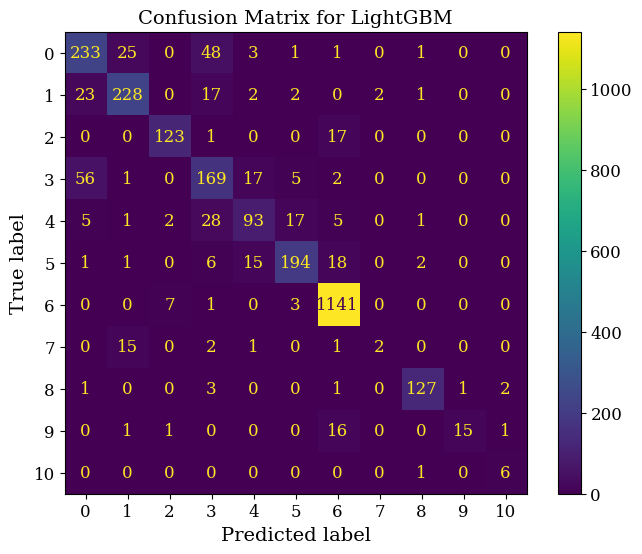

Feature Importance for LightGBM:
                       Feature  Importance
12                period_final        7707
6              phot_g_mean_mag        6602
1                          BII        6311
2                     parallax        5759
13                       R_gal        5737
0                          LII        5691
5                           pm        5597
4                        pmdec        5386
3                         pmra        5350
9                         g_rp        5027
8                         bp_g        4619
7                        bp_rp        4164
11  is_mean_cycle_period_final          60
10       is_bound_period_final           0


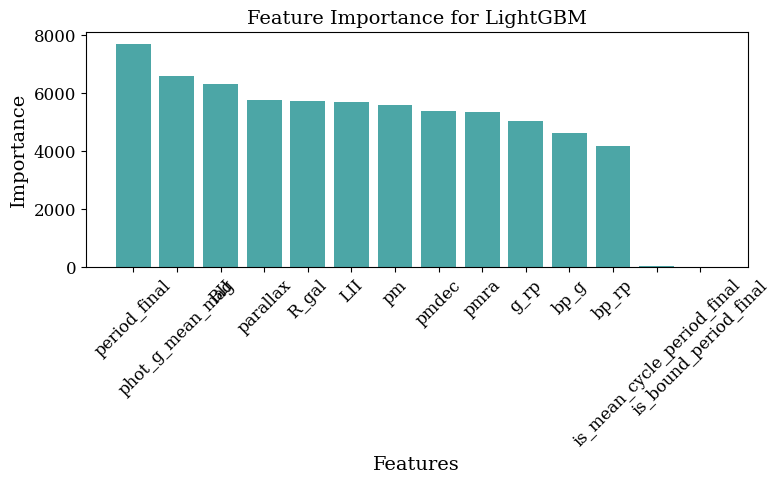

In [ ]:
# Матрица ошибок
conf_matrix_lgb = confusion_matrix(np.argmax(y_test_lgb, axis=1), y_test_pred_lgb)
disp = ConfusionMatrixDisplay(conf_matrix_lgb, display_labels=np.arange(y_spec.shape[1]))
disp.plot(cmap="viridis")
plt.title("Confusion Matrix for LightGBM")
plt.show()

# Важность признаков
feature_importance_lgb = pd.DataFrame({
    'Feature': X_spec.columns,
    'Importance': best_model_lgb.feature_importances_
}).sort_values(by='Importance', ascending=False)

# Вывод важности признаков
print("Feature Importance for LightGBM:")
print(feature_importance_lgb)

# Визуализация важности признаков
plt.figure(figsize=(8, 5))
plt.bar(feature_importance_lgb['Feature'], feature_importance_lgb['Importance'], color='teal', alpha=0.7)
plt.title('Feature Importance for LightGBM')
plt.ylabel('Importance')
plt.xlabel('Features')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Random forest

In [552]:
# Разделение данных
X_train_rf, X_test_rf, y_train_rf, y_test_rf = train_test_split(
    X_spec, np.argmax(y_spec, axis=1), test_size=0.2, random_state=42
)

In [554]:
# Целевая функция для Optuna
def objective_rf(trial):
    param_rf = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 200),
        "max_depth": trial.suggest_int("max_depth", 5, 15),
        "min_samples_split": trial.suggest_int("min_samples_split", 2, 10),
        "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 5),
        "max_features": trial.suggest_categorical("max_features", ["sqrt", "log2", None]),
        "random_state": 42
    }

    model_rf = RandomForestClassifier(**param_rf)

    # Кросс-валидация
    scores = cross_val_score(
        model_rf,
        X_train_rf,
        y_train_rf,
        scoring="f1_weighted",
        cv=5,
        n_jobs=-1
    )

    return np.mean(scores)

In [556]:
# Засекаем время начала
start_time_rf = time.time()

# Запуск Optuna
study_rf = optuna.create_study(direction="maximize")
study_rf.optimize(objective_rf, n_trials=50)

# Засекаем время окончания
end_time_rf = time.time()

# Вывод времени выполнения
execution_time_rf = end_time_rf - start_time_rf

[I 2025-01-13 13:34:49,428] A new study created in memory with name: no-name-b2d8928d-29d2-41c3-a413-e0834f49ab0b
[I 2025-01-13 13:34:52,778] Trial 0 finished with value: 0.8149461651531322 and parameters: {'n_estimators': 193, 'max_depth': 14, 'min_samples_split': 2, 'min_samples_leaf': 3, 'max_features': 'log2'}. Best is trial 0 with value: 0.8149461651531322.
[I 2025-01-13 13:34:54,383] Trial 1 finished with value: 0.8171065839918853 and parameters: {'n_estimators': 101, 'max_depth': 15, 'min_samples_split': 9, 'min_samples_leaf': 1, 'max_features': 'log2'}. Best is trial 1 with value: 0.8171065839918853.
[I 2025-01-13 13:34:55,797] Trial 2 finished with value: 0.8126320135865448 and parameters: {'n_estimators': 103, 'max_depth': 12, 'min_samples_split': 5, 'min_samples_leaf': 3, 'max_features': 'sqrt'}. Best is trial 1 with value: 0.8171065839918853.
[I 2025-01-13 13:34:58,408] Trial 3 finished with value: 0.8096265836476331 and parameters: {'n_estimators': 160, 'max_depth': 13, 'm

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-01-13 13:45:32,373] Trial 29 finished with value: 0.8327541918845416 and parameters: {'n_estimators': 142, 'max_depth': 14, 'min_samples_split': 2, 'min_samples_leaf': 3, 'max_features': None}. Best is trial 21 with value: 0.8336399541156221.
[I 2025-01-13 13:45:34,339] Trial 30 finished with value: 0.8139194866740441 and parameters: {'n_estimators': 120, 'max_depth': 14, 'min_samples_split': 3, 'min_samples_leaf': 3, 'max_features': 'log2'}. Best is trial 21 with value: 0.8336399541156221.
[I 2025-01-13 13:45:40,480] Trial 31 finished with value: 0.8333746845645511 and parameters: {'n_estimators': 83, 'max_depth': 13, 'min_samples_split': 4, 'min_samples_leaf': 2, 'max_features': None}. Best is trial 21 with value: 0.8336399541156221.
[I 2025-01-13 13:45:46,640] Trial 32 finished with value: 0.833010561032945 and parameters: {'n_estimators': 98, 'max_depth': 15, 'min_samples_split': 4, 'min_samples_leaf': 2, 'max_features': None}. Best is trial 21 with value: 0.833639954115622

In [ ]:
print(f"\nВремя выполнения: {execution_time_rf:.2f} секунд ({execution_time_rf / 60:.2f} минут)")

# Лучшие параметры
best_params_rf = study_rf.best_params
print("\nЛучшие параметры:", best_params_rf)


Время выполнения: 721.04 секунд (12.02 минут)

Лучшие параметры: {'n_estimators': 76, 'max_depth': 14, 'min_samples_split': 4, 'min_samples_leaf': 2, 'max_features': None}


In [ ]:
# Обучение с лучшими параметрами
best_model_rf = RandomForestClassifier(**best_params_rf, random_state=42)
best_model_rf.fit(X_train_rf, y_train_rf)

# Оценка модели
y_train_pred_rf = best_model_rf.predict(X_train_rf)
y_test_pred_rf = best_model_rf.predict(X_test_rf)

accuracy_train_rf = accuracy_score(y_train_rf, y_train_pred_rf)
accuracy_test_rf = accuracy_score(y_test_rf, y_test_pred_rf)

f1_weighted_train_rf = f1_score(y_train_rf, y_train_pred_rf, average='weighted')
f1_weighted_test_rf = f1_score(y_test_rf, y_test_pred_rf, average='weighted')

print("\nОценка модели:")
print(f"Accuracy (Train): {accuracy_train_rf:.4f}")
print(f"Accuracy (Test): {accuracy_test_rf:.4f}")
print(f"F1 Score Weighted (Train): {f1_weighted_train_rf:.4f}")
print(f"F1 Score Weighted (Test): {f1_weighted_test_rf:.4f}")


Оценка модели:
Accuracy (Train): 0.9660
Accuracy (Test): 0.8428
F1 Score Weighted (Train): 0.9653
F1 Score Weighted (Test): 0.8382


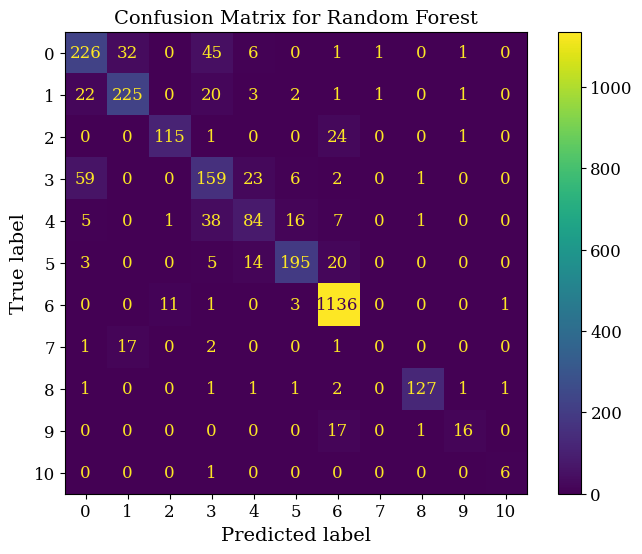

In [ ]:
# Матрица ошибок
conf_matrix_rf = confusion_matrix(y_test_rf, y_test_pred_rf)
disp = ConfusionMatrixDisplay(conf_matrix_rf, display_labels=np.arange(y_spec.shape[1]))
disp.plot(cmap="viridis")
plt.title("Confusion Matrix for Random Forest")
plt.show()

# Важность признаков
feature_importance_rf = pd.DataFrame({
    'Feature': X_spec.columns,
    'Importance': best_model_rf.feature_importances_
}).sort_values(by='Importance', ascending=False)

Feature Importance for Random Forest:
                       Feature  Importance
7                        bp_rp    0.339991
12                period_final    0.297482
2                     parallax    0.071150
6              phot_g_mean_mag    0.062212
8                         bp_g    0.053342
9                         g_rp    0.045330
5                           pm    0.028274
1                          BII    0.024944
13                       R_gal    0.021798
0                          LII    0.018575
4                        pmdec    0.017280
3                         pmra    0.016377
11  is_mean_cycle_period_final    0.003244
10       is_bound_period_final    0.000000


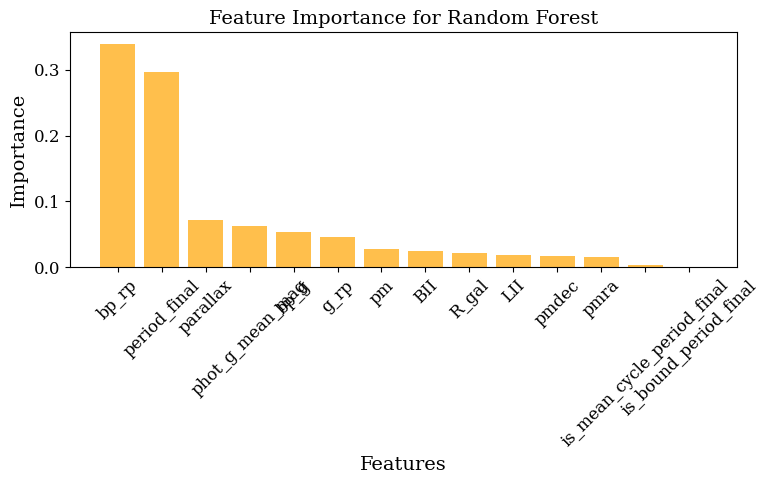

In [ ]:
# Вывод важности признаков
print("Feature Importance for Random Forest:")
print(feature_importance_rf)

# Визуализация важности признаков
plt.figure(figsize=(8, 5))
plt.bar(feature_importance_rf['Feature'], feature_importance_rf['Importance'], color='orange', alpha=0.7)
plt.title('Feature Importance for Random Forest')
plt.ylabel('Importance')
plt.xlabel('Features')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Neural network

In [ ]:
# Разделение данных
X_train_nn, X_test_nn, y_train_nn, y_test_nn = train_test_split(
    X_spec, np.argmax(y_spec, axis=1), test_size=0.2, random_state=42
)

In [ ]:
# Целевая функция для Optuna
def objective_nn(trial):
    # Гиперпараметры
    num_layers = trial.suggest_int("num_layers", 1, 3)
    units = trial.suggest_int("units", 64, 256)
    dropout_rate = trial.suggest_float("dropout_rate", 0.2, 0.5)
    learning_rate = trial.suggest_float("learning_rate", 1e-4, 1e-2, log=True)
    
    # Создание модели
    model = Sequential()
    model.add(Dense(units, activation="relu", input_shape=(X_train_nn.shape[1],)))
    model.add(Dropout(dropout_rate))
    
    for _ in range(num_layers - 1):
        model.add(Dense(units, activation="relu"))
        model.add(Dropout(dropout_rate))
    
    model.add(Dense(y_spec.shape[1], activation="softmax"))
    
    optimizer = Adam(learning_rate=learning_rate)
    model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics=["accuracy"])
    
    # Обучение модели
    model.fit(X_train_nn, y_train_nn, epochs=10, batch_size=32, verbose=0)
    
    # Оценка модели
    y_pred_nn = np.argmax(model.predict(X_test_nn), axis=1)
    return f1_score(y_test_nn, y_pred_nn, average="weighted")

In [ ]:
# Засекаем время начала
start_time_nn = time.time()

# Запуск Optuna
study_nn = optuna.create_study(direction="maximize")
study_nn.optimize(objective_nn, n_trials=50)

# Засекаем время окончания
end_time_nn = time.time()

# Вывод времени выполнения
execution_time_nn = end_time_nn - start_time_nn

[I 2025-01-13 13:46:56,531] A new study created in memory with name: no-name-52236d9b-c6d7-4df1-b742-283b0ea8cec7


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 359us/step


[I 2025-01-13 13:46:58,394] Trial 0 finished with value: 0.5844221188779263 and parameters: {'num_layers': 1, 'units': 170, 'dropout_rate': 0.4200506857477373, 'learning_rate': 0.002726604585069167}. Best is trial 0 with value: 0.5844221188779263.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 488us/step


[I 2025-01-13 13:47:00,896] Trial 1 finished with value: 0.3036886176563941 and parameters: {'num_layers': 3, 'units': 91, 'dropout_rate': 0.2210433497451207, 'learning_rate': 0.0002309987585632601}. Best is trial 0 with value: 0.5844221188779263.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 411us/step


[I 2025-01-13 13:47:03,354] Trial 2 finished with value: 0.542858811016589 and parameters: {'num_layers': 2, 'units': 132, 'dropout_rate': 0.4655367517246663, 'learning_rate': 0.0022768323514022666}. Best is trial 0 with value: 0.5844221188779263.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 404us/step


[I 2025-01-13 13:47:05,024] Trial 3 finished with value: 0.49001269677928877 and parameters: {'num_layers': 1, 'units': 234, 'dropout_rate': 0.4214408677743395, 'learning_rate': 0.00012018793651158252}. Best is trial 0 with value: 0.5844221188779263.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 415us/step


[I 2025-01-13 13:47:06,752] Trial 4 finished with value: 0.6385956580944961 and parameters: {'num_layers': 1, 'units': 243, 'dropout_rate': 0.2078039671076533, 'learning_rate': 0.0005752841558134456}. Best is trial 4 with value: 0.6385956580944961.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 390us/step


[I 2025-01-13 13:47:08,289] Trial 5 finished with value: 0.6141001223724564 and parameters: {'num_layers': 1, 'units': 115, 'dropout_rate': 0.27269035015354187, 'learning_rate': 0.0009298633222739416}. Best is trial 4 with value: 0.6385956580944961.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 509us/step


[I 2025-01-13 13:47:12,402] Trial 6 finished with value: 0.5582135785774199 and parameters: {'num_layers': 3, 'units': 216, 'dropout_rate': 0.4374165612260616, 'learning_rate': 0.0015504970490223926}. Best is trial 4 with value: 0.6385956580944961.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 471us/step


[I 2025-01-13 13:47:14,752] Trial 7 finished with value: 0.25278036612376165 and parameters: {'num_layers': 3, 'units': 104, 'dropout_rate': 0.3417632796250227, 'learning_rate': 0.00013887691169337882}. Best is trial 4 with value: 0.6385956580944961.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 453us/step


[I 2025-01-13 13:47:17,280] Trial 8 finished with value: 0.26057595731028177 and parameters: {'num_layers': 3, 'units': 120, 'dropout_rate': 0.3257661980495051, 'learning_rate': 0.0001124989019404556}. Best is trial 4 with value: 0.6385956580944961.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 370us/step


[I 2025-01-13 13:47:18,845] Trial 9 finished with value: 0.5152932826963007 and parameters: {'num_layers': 1, 'units': 227, 'dropout_rate': 0.4528304396739397, 'learning_rate': 0.00014150287545330713}. Best is trial 4 with value: 0.6385956580944961.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 436us/step


[I 2025-01-13 13:47:21,565] Trial 10 finished with value: 0.570361207238679 and parameters: {'num_layers': 2, 'units': 189, 'dropout_rate': 0.2410166944809407, 'learning_rate': 0.0006328018842200865}. Best is trial 4 with value: 0.6385956580944961.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 359us/step


[I 2025-01-13 13:47:23,228] Trial 11 finished with value: 0.5975958528518487 and parameters: {'num_layers': 1, 'units': 256, 'dropout_rate': 0.27375444164765383, 'learning_rate': 0.000597500727193538}. Best is trial 4 with value: 0.6385956580944961.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 412us/step


[I 2025-01-13 13:47:25,093] Trial 12 finished with value: 0.5394639633085532 and parameters: {'num_layers': 2, 'units': 66, 'dropout_rate': 0.2806897765721364, 'learning_rate': 0.007699310627022504}. Best is trial 4 with value: 0.6385956580944961.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 345us/step


[I 2025-01-13 13:47:26,612] Trial 13 finished with value: 0.5739886817123366 and parameters: {'num_layers': 1, 'units': 149, 'dropout_rate': 0.20160974629352346, 'learning_rate': 0.0004249067385637271}. Best is trial 4 with value: 0.6385956580944961.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 365us/step


[I 2025-01-13 13:47:28,180] Trial 14 finished with value: 0.6435451388129805 and parameters: {'num_layers': 1, 'units': 190, 'dropout_rate': 0.27819612512417796, 'learning_rate': 0.0011174397349465032}. Best is trial 14 with value: 0.6435451388129805.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 422us/step


[I 2025-01-13 13:47:30,857] Trial 15 finished with value: 0.47385757729526196 and parameters: {'num_layers': 2, 'units': 196, 'dropout_rate': 0.3021117831754567, 'learning_rate': 0.00032310631907682066}. Best is trial 14 with value: 0.6435451388129805.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 361us/step


[I 2025-01-13 13:47:32,454] Trial 16 finished with value: 0.6219039986940349 and parameters: {'num_layers': 1, 'units': 248, 'dropout_rate': 0.36575722931853977, 'learning_rate': 0.0012577710838776249}. Best is trial 14 with value: 0.6435451388129805.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 434us/step


[I 2025-01-13 13:47:35,148] Trial 17 finished with value: 0.6338663519107383 and parameters: {'num_layers': 2, 'units': 203, 'dropout_rate': 0.24386159327319173, 'learning_rate': 0.003637835134021067}. Best is trial 14 with value: 0.6435451388129805.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 341us/step


[I 2025-01-13 13:47:36,678] Trial 18 finished with value: 0.5995385292624698 and parameters: {'num_layers': 1, 'units': 168, 'dropout_rate': 0.37910592543610727, 'learning_rate': 0.0008138374790494503}. Best is trial 14 with value: 0.6435451388129805.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 356us/step


[I 2025-01-13 13:47:38,211] Trial 19 finished with value: 0.5978816403464243 and parameters: {'num_layers': 1, 'units': 185, 'dropout_rate': 0.20364148936489732, 'learning_rate': 0.008124318683414643}. Best is trial 14 with value: 0.6435451388129805.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 437us/step


[I 2025-01-13 13:47:41,120] Trial 20 finished with value: 0.5939107470742977 and parameters: {'num_layers': 2, 'units': 213, 'dropout_rate': 0.24428919359437226, 'learning_rate': 0.004833923296266878}. Best is trial 14 with value: 0.6435451388129805.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 424us/step


[I 2025-01-13 13:47:43,882] Trial 21 finished with value: 0.6433796716304861 and parameters: {'num_layers': 2, 'units': 209, 'dropout_rate': 0.23830829239248333, 'learning_rate': 0.003533534928196975}. Best is trial 14 with value: 0.6435451388129805.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 436us/step


[I 2025-01-13 13:47:47,379] Trial 22 finished with value: 0.6529941709473395 and parameters: {'num_layers': 2, 'units': 231, 'dropout_rate': 0.30197370236233234, 'learning_rate': 0.0018659489459046195}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step


[I 2025-01-13 13:47:50,420] Trial 23 finished with value: 0.6162338718503307 and parameters: {'num_layers': 2, 'units': 225, 'dropout_rate': 0.31130953204097284, 'learning_rate': 0.0018470175541222336}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 435us/step


[I 2025-01-13 13:47:52,861] Trial 24 finished with value: 0.6146445892390885 and parameters: {'num_layers': 2, 'units': 178, 'dropout_rate': 0.2785394060821246, 'learning_rate': 0.004793026216921567}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 487us/step


[I 2025-01-13 13:47:56,646] Trial 25 finished with value: 0.4989119381701992 and parameters: {'num_layers': 3, 'units': 206, 'dropout_rate': 0.4906224812918033, 'learning_rate': 0.0030870151846272564}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 422us/step


[I 2025-01-13 13:47:58,955] Trial 26 finished with value: 0.5984448028273628 and parameters: {'num_layers': 2, 'units': 159, 'dropout_rate': 0.29832348954733534, 'learning_rate': 0.0013772508408080462}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 448us/step


[I 2025-01-13 13:48:02,443] Trial 27 finished with value: 0.5990653994076024 and parameters: {'num_layers': 2, 'units': 234, 'dropout_rate': 0.257174107460309, 'learning_rate': 0.0020036059116744403}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 566us/step


[I 2025-01-13 13:48:07,277] Trial 28 finished with value: 0.5923560197633921 and parameters: {'num_layers': 3, 'units': 217, 'dropout_rate': 0.3275967251101483, 'learning_rate': 0.005032487269271748}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 425us/step


[I 2025-01-13 13:48:09,626] Trial 29 finished with value: 0.6024563523133307 and parameters: {'num_layers': 2, 'units': 151, 'dropout_rate': 0.37679932819595746, 'learning_rate': 0.002610062171876429}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 430us/step


[I 2025-01-13 13:48:12,062] Trial 30 finished with value: 0.6113526676995142 and parameters: {'num_layers': 2, 'units': 174, 'dropout_rate': 0.22879408984513971, 'learning_rate': 0.0011266753970148493}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 379us/step


[I 2025-01-13 13:48:13,664] Trial 31 finished with value: 0.6018364205628984 and parameters: {'num_layers': 1, 'units': 238, 'dropout_rate': 0.2583489195522275, 'learning_rate': 0.0005372405068561573}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 359us/step


[I 2025-01-13 13:48:15,307] Trial 32 finished with value: 0.6139737734800246 and parameters: {'num_layers': 1, 'units': 242, 'dropout_rate': 0.2135496094219437, 'learning_rate': 0.0007821646433295299}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 374us/step


[I 2025-01-13 13:48:16,954] Trial 33 finished with value: 0.5911617026493806 and parameters: {'num_layers': 1, 'units': 255, 'dropout_rate': 0.22791249442438008, 'learning_rate': 0.0002561680698975597}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 367us/step


[I 2025-01-13 13:48:18,543] Trial 34 finished with value: 0.6359193676283214 and parameters: {'num_layers': 1, 'units': 224, 'dropout_rate': 0.29725299076680994, 'learning_rate': 0.003531562132175328}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 388us/step


[I 2025-01-13 13:48:20,132] Trial 35 finished with value: 0.6224397357265646 and parameters: {'num_layers': 1, 'units': 196, 'dropout_rate': 0.25690589457191204, 'learning_rate': 0.0016865202964132704}. Best is trial 22 with value: 0.6529941709473395.


85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 461us/step


[I 2025-01-13 13:48:23,111] Trial 36 finished with value: 0.5310162535701638 and parameters: {'num_layers': 2, 'units': 206, 'dropout_rate': 0.2240430053495469, 'learning_rate': 0.00042633292826287734}. Best is trial 22 with value: 0.6529941709473395.
[W 2025-01-13 13:48:23,886] Trial 37 failed with parameters: {'num_layers': 3, 'units': 242, 'dropout_rate': 0.28620030005751346, 'learning_rate': 0.002242586920312003} because of the following error: InvalidArgumentError().
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.11/site-packages/optuna/study/_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/343263379.py", line 24, in objective_nn
    model.fit(X_train_nn, y_train_nn, epochs=10, batch_size=32, verbose=0)
  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/utils/traceback_utils.py", line 122, in error_handler
    raise e.w

InvalidArgumentError: Graph execution error:

Detected at node adam/truediv_15 defined at (most recent call last):
  File "<frozen runpy>", line 198, in _run_module_as_main

  File "<frozen runpy>", line 88, in _run_code

  File "/opt/anaconda3/lib/python3.11/site-packages/ipykernel_launcher.py", line 17, in <module>

  File "/opt/anaconda3/lib/python3.11/site-packages/traitlets/config/application.py", line 992, in launch_instance

  File "/opt/anaconda3/lib/python3.11/site-packages/ipykernel/kernelapp.py", line 701, in start

  File "/opt/anaconda3/lib/python3.11/site-packages/tornado/platform/asyncio.py", line 195, in start

  File "/opt/anaconda3/lib/python3.11/asyncio/base_events.py", line 607, in run_forever

  File "/opt/anaconda3/lib/python3.11/asyncio/base_events.py", line 1922, in _run_once

  File "/opt/anaconda3/lib/python3.11/asyncio/events.py", line 80, in _run

  File "/opt/anaconda3/lib/python3.11/site-packages/ipykernel/kernelbase.py", line 534, in dispatch_queue

  File "/opt/anaconda3/lib/python3.11/site-packages/ipykernel/kernelbase.py", line 523, in process_one

  File "/opt/anaconda3/lib/python3.11/site-packages/ipykernel/kernelbase.py", line 429, in dispatch_shell

  File "/opt/anaconda3/lib/python3.11/site-packages/ipykernel/kernelbase.py", line 767, in execute_request

  File "/opt/anaconda3/lib/python3.11/site-packages/ipykernel/ipkernel.py", line 429, in do_execute

  File "/opt/anaconda3/lib/python3.11/site-packages/ipykernel/zmqshell.py", line 549, in run_cell

  File "/opt/anaconda3/lib/python3.11/site-packages/IPython/core/interactiveshell.py", line 3051, in run_cell

  File "/opt/anaconda3/lib/python3.11/site-packages/IPython/core/interactiveshell.py", line 3106, in _run_cell

  File "/opt/anaconda3/lib/python3.11/site-packages/IPython/core/async_helpers.py", line 129, in _pseudo_sync_runner

  File "/opt/anaconda3/lib/python3.11/site-packages/IPython/core/interactiveshell.py", line 3311, in run_cell_async

  File "/opt/anaconda3/lib/python3.11/site-packages/IPython/core/interactiveshell.py", line 3493, in run_ast_nodes

  File "/opt/anaconda3/lib/python3.11/site-packages/IPython/core/interactiveshell.py", line 3553, in run_code

  File "/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/839766723.py", line 6, in <module>

  File "/opt/anaconda3/lib/python3.11/site-packages/optuna/study/study.py", line 475, in optimize

  File "/opt/anaconda3/lib/python3.11/site-packages/optuna/study/_optimize.py", line 63, in _optimize

  File "/opt/anaconda3/lib/python3.11/site-packages/optuna/study/_optimize.py", line 160, in _optimize_sequential

  File "/opt/anaconda3/lib/python3.11/site-packages/optuna/study/_optimize.py", line 197, in _run_trial

  File "/var/folders/kv/prhthx396zd4k1d7f55bdztc0000gn/T/ipykernel_2700/343263379.py", line 24, in objective_nn

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/utils/traceback_utils.py", line 117, in error_handler

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/backend/tensorflow/trainer.py", line 320, in fit

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/backend/tensorflow/trainer.py", line 121, in one_step_on_iterator

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/backend/tensorflow/trainer.py", line 108, in one_step_on_data

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/backend/tensorflow/trainer.py", line 73, in train_step

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/optimizers/base_optimizer.py", line 344, in apply_gradients

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/optimizers/base_optimizer.py", line 409, in apply

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/optimizers/base_optimizer.py", line 472, in _backend_apply_gradients

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/backend/tensorflow/optimizer.py", line 122, in _backend_update_step

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/backend/tensorflow/optimizer.py", line 136, in _distributed_tf_update_step

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/backend/tensorflow/optimizer.py", line 133, in apply_grad_to_update_var

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/optimizers/adam.py", line 147, in update_step

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/ops/numpy.py", line 5876, in divide

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/backend/tensorflow/sparse.py", line 780, in sparse_wrapper

  File "/opt/anaconda3/lib/python3.11/site-packages/keras/src/backend/tensorflow/numpy.py", line 2316, in divide

Incompatible shapes: [0] vs. [11]
	 [[{{node adam/truediv_15}}]] [Op:__inference_one_step_on_iterator_5762597]

In [ ]:
print(f"\nВремя выполнения: {execution_time_nn:.2f} секунд ({execution_time_nn / 60:.2f} минут)")

# Лучшие параметры
best_params_nn = study_nn.best_params
print("\nЛучшие параметры:", best_params_nn)

In [ ]:
# Обучение с лучшими параметрами
def build_best_model(best_params):
    model = Sequential()
    model.add(Dense(best_params["units"], activation="relu", input_shape=(X_train_nn.shape[1],)))
    model.add(Dropout(best_params["dropout_rate"]))
    
    for _ in range(best_params["num_layers"] - 1):
        model.add(Dense(best_params["units"], activation="relu"))
        model.add(Dropout(best_params["dropout_rate"]))
    
    model.add(Dense(y_spec.shape[1], activation="softmax"))
    
    optimizer = Adam(learning_rate=best_params["learning_rate"])
    model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics=["accuracy"])
    return model

best_model_nn = build_best_model(best_params_nn)
best_model_nn.fit(X_train_nn, y_train_nn, epochs=50, batch_size=32, verbose=1)

# Оценка модели
y_train_pred_nn = np.argmax(best_model_nn.predict(X_train_nn), axis=1)
y_test_pred_nn = np.argmax(best_model_nn.predict(X_test_nn), axis=1)

accuracy_train_nn = accuracy_score(y_train_nn, y_train_pred_nn)
accuracy_test_nn = accuracy_score(y_test_nn, y_test_pred_nn)

f1_weighted_train_nn = f1_score(y_train_nn, y_train_pred_nn, average="weighted")
f1_weighted_test_nn = f1_score(y_test_nn, y_test_pred_nn, average="weighted")

print("\nОценка модели:")
print(f"Accuracy (Train): {accuracy_train_nn:.4f}")
print(f"Accuracy (Test): {accuracy_test_nn:.4f}")
print(f"F1 Score Weighted (Train): {f1_weighted_train_nn:.4f}")
print(f"F1 Score Weighted (Test): {f1_weighted_test_nn:.4f}")

In [ ]:
# Матрица ошибок
conf_matrix_nn = confusion_matrix(y_test_nn, y_test_pred_nn)
disp = ConfusionMatrixDisplay(conf_matrix_nn, display_labels=np.arange(y_spec.shape[1]))
disp.plot(cmap="viridis")
plt.title("Confusion Matrix for Neural Network")
plt.show()